<a href="https://colab.research.google.com/github/BrandonFylnn/google-landmark/blob/master/vggCopy_of_mint_Copy_of_Grad_CAM(unequal_dataset).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Importations

In [ ]:
import os
import numpy as np
import cv2                 
from random import shuffle
from tqdm import tqdm  
import tensorflow as tf 
from tensorflow.keras import Model
from tensorflow.keras.utils import plot_model
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import ReduceLROnPlateau , ModelCheckpoint
from collections import Counter

from sklearn.metrics import mean_absolute_error, roc_auc_score
from sklearn.metrics import classification_report, f1_score, cohen_kappa_score
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score
from sklearn.preprocessing import LabelBinarizer
from tensorflow.keras.utils import to_categorical

In [ ]:
tf.test.is_gpu_available()

Instructions for updating:
Use `tf.config.list_physical_devices('GPU')` instead.


True

In [ ]:
TrianImage= '/content/drive/Shared drives/Senior project/unequal data/train'
TestImage='/content/drive/Shared drives/Senior project/unequal data/test'
Normalimages = os.listdir('/content/drive/Shared drives/Senior project/unequal data/train/NORMAL')
Pneumonaimages = os.listdir('/content/drive/Shared drives/Senior project/unequal data/train/PNEUMONIA')
COVID19images = os.listdir('/content/drive/Shared drives/Senior project/unequal data/train/COVID19')

In [ ]:
print(len(Normalimages), len(Pneumonaimages), len(COVID19images))
NUM_TRAINING_IMAGES = len(Normalimages) + len(Pneumonaimages) + len(COVID19images)
print(NUM_TRAINING_IMAGES)

1266 3418 460
5144


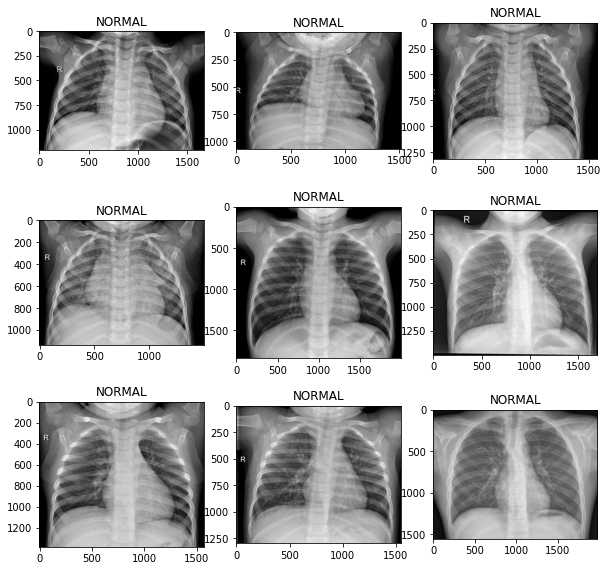

In [ ]:
plt.figure(figsize=(10,10))
for i in range(9):
    plt.subplot(3, 3, i + 1)
    plt.imshow(plt.imread(os.path.join(TrianImage + "/NORMAL",Normalimages[i])),cmap='gray')
    plt.title('NORMAL')
plt.show()

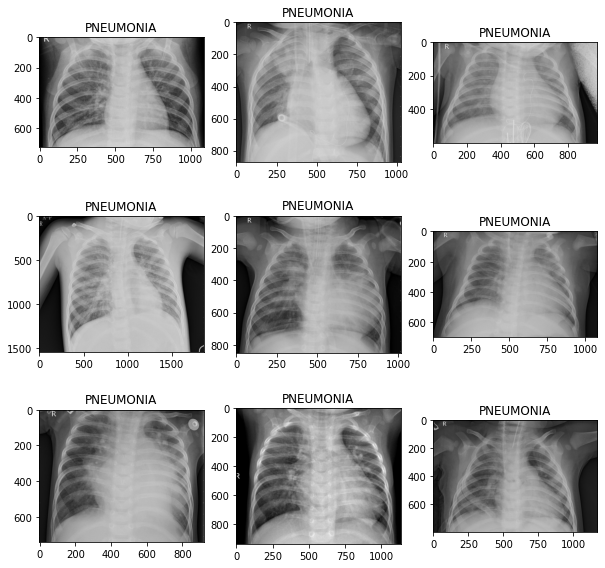

In [ ]:
plt.figure(figsize=(10,10))
for i in range(9):
    plt.subplot(3, 3, i + 1)
    plt.imshow(plt.imread(os.path.join(TrianImage + "/PNEUMONIA",Pneumonaimages[i])),cmap='gray')
    plt.title("PNEUMONIA")
plt.show()

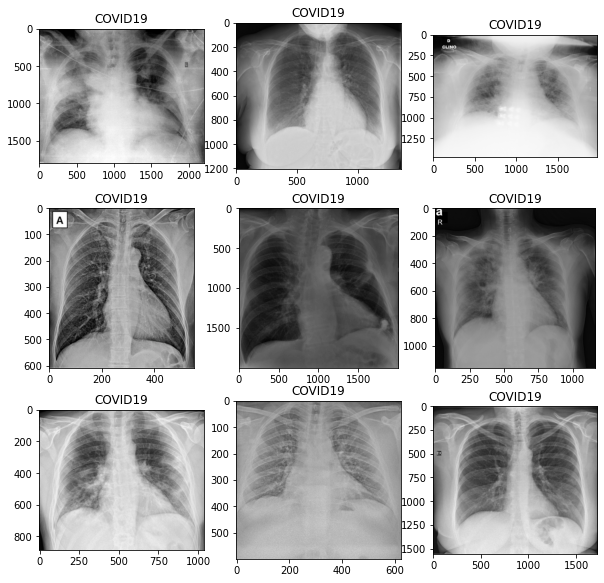

In [ ]:
plt.figure(figsize=(10,10))
for i in range(9):
    plt.subplot(3, 3, i + 1)
    plt.imshow(plt.imread(os.path.join(TrianImage + "/COVID19",COVID19images[i])),cmap='gray')
    plt.title("COVID19")
plt.show()

In [ ]:
 
image_size = 224 
BATCH_SIZE = 64 
STEPS_PER_EPOCH = NUM_TRAINING_IMAGES // BATCH_SIZE
 
data_path = '/content/drive/Shared drives/Senior project/unequal data'
 
train_datagen = ImageDataGenerator(rescale = 1./255,
                                   zoom_range = 0.2,
                                   rotation_range=15,
                                   horizontal_flip = True)
 
test_datagen = ImageDataGenerator(rescale = 1./255)
 
training_set = train_datagen.flow_from_directory('/content/drive/Shared drives/Senior project/unequal data/train',
                                                 target_size = (image_size, image_size),
                                                 batch_size = BATCH_SIZE,
                                                 class_mode = 'categorical',
                                                 shuffle=True
                                                 )
 
testing_set = test_datagen.flow_from_directory('/content/drive/Shared drives/Senior project/unequal data/test',
                                            target_size = (image_size, image_size),
                                            batch_size = BATCH_SIZE,
                                            class_mode = 'categorical',
                                            shuffle=True
                                            )

Found 5144 images belonging to 3 classes.
Found 1288 images belonging to 3 classes.


In [ ]:
print("train batch ", training_set.__getitem__(0)[0].shape)
print("test batch ", testing_set.__getitem__(0)[0].shape)
print("sample train label \n", training_set.__getitem__(0)[1][:5])

train batch  (64, 224, 224, 3)
test batch  (64, 224, 224, 3)
sample train label 
 [[0. 0. 1.]
 [0. 0. 1.]
 [0. 0. 1.]
 [0. 1. 0.]
 [0. 0. 1.]]


In [ ]:
training_set.class_indices
testing_set.class_indices

{'COVID19': 0, 'NORMAL': 1, 'PNEUMONIA': 2}

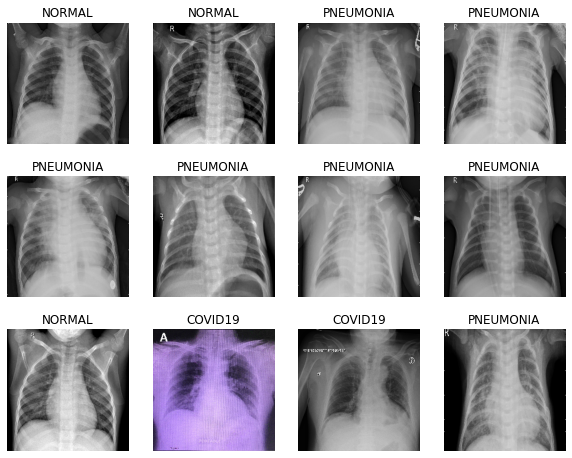

In [ ]:
labels = ['COVID19', 'NORMAL', 'PNEUMONIA']
 
sample_data = testing_set.__getitem__(1)[0] 
sample_label = testing_set.__getitem__(1)[1] 
 
plt.figure(figsize=(10,8))
for i in range(12):
    plt.subplot(3, 4, i + 1)
    plt.axis('off')
    plt.imshow(sample_data[i])
    plt.title(labels[np.argmax(sample_label[i])])

In [ ]:
!pip install efficientnet
import efficientnet.tfkeras as efn

     |████████████████████████████████| 51kB 4.4MB/s 


In [ ]:
def display_training_curves(training, validation, title, subplot):
    if subplot%10==1: # set up the subplots on the first call
        plt.subplots(figsize=(10,10), facecolor='#F0F0F0')
        plt.tight_layout()
    ax = plt.subplot(subplot)
    ax.set_facecolor('#F8F8F8')
    ax.plot(training)
    ax.plot(validation)
    ax.set_title('model '+ title)
    ax.set_ylabel(title)
    ax.set_xlabel('epoch')
    ax.legend(['train', 'valid.'])

In [ ]:
# https://keras.io/examples/vision/grad_cam/
from tensorflow import keras
 
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, classifier_layer_names):
    # First, we create a model that maps the input image to the activations
    # of the last conv layer
    last_conv_layer = model.get_layer(last_conv_layer_name)
    last_conv_layer_model = keras.Model(model.inputs, last_conv_layer.output)
 
    # Second, we create a model that maps the activations of the last conv
    # layer to the final class predictions
    classifier_input = keras.Input(shape=last_conv_layer.output.shape[1:])
    x = classifier_input
    for layer_name in classifier_layer_names:
        x = model.get_layer(layer_name)(x)
    classifier_model = keras.Model(classifier_input, x)
 
    # Then, we compute the gradient of the top predicted class for our input image
    # with respect to the activations of the last conv layer
    with tf.GradientTape() as tape:
        # Compute activations of the last conv layer and make the tape watch it
        last_conv_layer_output = last_conv_layer_model(img_array)
        tape.watch(last_conv_layer_output)
        # Compute class predictions
        preds = classifier_model(last_conv_layer_output)
        top_pred_index = tf.argmax(preds[0])
        top_class_channel = preds[:, top_pred_index]
 
    # This is the gradient of the top predicted class with regard to
    # the output feature map of the last conv layer
    grads = tape.gradient(top_class_channel, last_conv_layer_output)
 
    # This is a vector where each entry is the mean intensity of the gradient
    # over a specific feature map channel
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
 
    # We multiply each channel in the feature map array
    # by "how important this channel is" with regard to the top predicted class
    last_conv_layer_output = last_conv_layer_output.numpy()[0]
    pooled_grads = pooled_grads.numpy()
    for i in range(pooled_grads.shape[-1]):
        last_conv_layer_output[:, :, i] *= pooled_grads[i]
 
    # The channel-wise mean of the resulting feature map
    # is our heatmap of class activation
    heatmap = np.mean(last_conv_layer_output, axis=-1)
 
    # For visualization purpose, we will also normalize the heatmap between 0 & 1
    heatmap = np.maximum(heatmap, 0) / np.max(heatmap)
    return heatmap, top_pred_index.numpy()

In [ ]:
# https://keras.io/examples/vision/grad_cam/
def superimposed_img(image, heatmap):
    # We rescale heatmap to a range 0-255
    heatmap = np.uint8(255 * heatmap)

    # We use jet colormap to colorize heatmap
    jet = cm.get_cmap("jet")

    # We use RGB values of the colormap
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    # We create an image with RGB colorized heatmap
    jet_heatmap = keras.preprocessing.image.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((image_size, image_size))
    jet_heatmap = keras.preprocessing.image.img_to_array(jet_heatmap)

    # Superimpose the heatmap on original image
    superimposed_img = jet_heatmap * 0.4 + image
    superimposed_img = keras.preprocessing.image.array_to_img(superimposed_img)
    return superimposed_img

In [ ]:
# label smoothing https://www.linkedin.com/pulse/label-smoothing-solving-overfitting-overconfidence-code-sobh-phd/
def categorical_smooth_loss(y_true, y_pred, label_smoothing=0.1):
    loss = tf.keras.losses.categorical_crossentropy(y_true, y_pred, label_smoothing=label_smoothing)
    return loss

In [ ]:
# training call backs 
lr_reduce = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, epsilon=0.0001, patience=3, verbose=1)
es_callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, verbose=1)

In [ ]:
# https://stackoverflow.com/questions/42586475/is-it-possible-to-automatically-infer-the-class-weight-from-flow-from-directory
counter = Counter(training_set.classes)                          
max_val = float(max(counter.values()))       
class_weights = {class_id : max_val/num_images for class_id, num_images in counter.items()}
class_weights

{0: 7.430434782608696, 1: 2.6998420221169037, 2: 1.0}

In [ ]:
# dfault input shapes 

print(tf.keras.applications.DenseNet201(weights='imagenet').input_shape)
# print(efn.EfficientNetB7(weights='imagenet').input_shape) 
print(tf.keras.applications.VGG16(weights='imagenet').input_shape) 
print(tf.keras.applications.ResNet50(weights='imagenet').input_shape)

82526208/82524592 [==============================] - 1s 0us/step
(None, 224, 224, 3)
553467904/553467096 [==============================] - 3s 0us/step
(None, 224, 224, 3)
102973440/102967424 [==============================] - 1s 0us/step
(None, 224, 224, 3)


# DenseNet

In [ ]:
pretrained_densenet = tf.keras.applications.DenseNet201(input_shape=(image_size, image_size, 3), weights='imagenet', include_top=False)
 
for layer in pretrained_densenet.layers:
  layer.trainable = False
 
x1 = pretrained_densenet.output
x1 = tf.keras.layers.AveragePooling2D(name="averagepooling2d_head")(x1)
x1 = tf.keras.layers.Flatten(name="flatten_head")(x1)
x1 = tf.keras.layers.Dense(64, activation="relu", name="dense_head")(x1)
x1 = tf.keras.layers.Dropout(0.5, name="dropout_head")(x1)
model_out = tf.keras.layers.Dense(3, activation='softmax', name="predictions_head")(x1)
 
model_densenet = Model(inputs=pretrained_densenet.input, outputs=model_out)
model_densenet.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),loss=categorical_smooth_loss,metrics=['accuracy',tf.keras.metrics.Precision(),tf.keras.metrics.Recall()])
 
model_densenet.summary()

74842112/74836368 [==============================] - 0s 0us/step
Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
zero_padding2d_2 (ZeroPadding2D (None, 230, 230, 3)  0           input_5[0][0]                    
__________________________________________________________________________________________________
conv1/conv (Conv2D)             (None, 112, 112, 64) 9408        zero_padding2d_2[0][0]           
__________________________________________________________________________________________________
conv1/bn (BatchNormalization)   (None, 112, 112, 64) 256         conv1/conv[0][0]                 
_____________________________

In [ ]:
history_densenet = model_densenet.fit_generator(training_set, validation_data=testing_set, callbacks=[lr_reduce, es_callback], epochs=30)   

/usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/engine/training.py:1844: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Epoch 1/30
81/81 [==============================] - 2036s 25s/step - loss: 0.8425 - accuracy: 0.7235 - precision: 0.7441 - recall: 0.6827 - val_loss: 0.4569 - val_accuracy: 0.9099 - val_precision: 0.9232 - val_recall: 0.8960
Epoch 2/30
81/81 [==============================] - 190s 2s/step - loss: 0.5018 - accuracy: 0.9098 - precision: 0.9247 - recall: 0.8833 - val_loss: 0.4501 - val_accuracy: 0.9216 - val_precision: 0.9277 - val_recall: 0.9061
Epoch 3/30
81/81 [==============================] - 189s 2s/step - loss: 0.4776 - accuracy: 0.9154 - precision: 0.9343 - recall: 0.8915 - val_loss: 0.4328 - val_accuracy: 0.9309 - val_precision: 0.9369 - val_recall: 0.9099
Epoch 4/30
81/81 [==============================] - 189s 2s/step - loss: 0.4612 - accuracy: 0.9236 - precision: 0.9366 - recall: 0.9078 - val_loss: 0.4274 - val_accuracy: 0.9340 - val_precision: 0.9392 - val_recall: 0.9239
Epoch 5/30
81/81 [==============================] - 189s 2s/step - loss: 0.4530 - accuracy: 0.9340 - preci

In [ ]:
model_densenet.save("model_densenet_30_09596.h5")
print(history_densenet.history.keys())

dict_keys(['loss', 'accuracy', 'precision', 'recall', 'val_loss', 'val_accuracy', 'val_precision', 'val_recall', 'lr'])


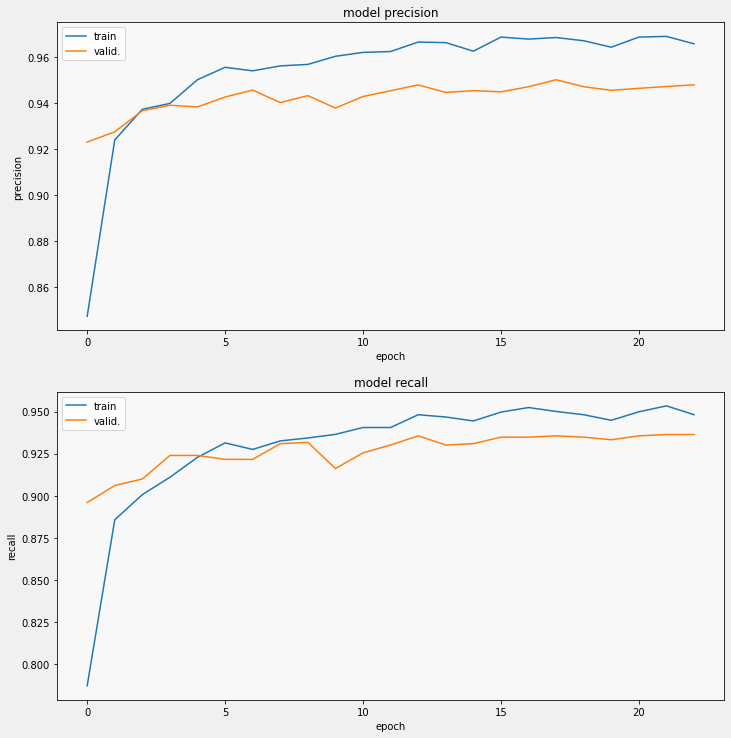

In [ ]:
display_training_curves(history_densenet.history['precision'], history_densenet.history['val_precision'], 'precision', 211)
display_training_curves(history_densenet.history['recall'], history_densenet.history['val_recall'], 'recall', 212)

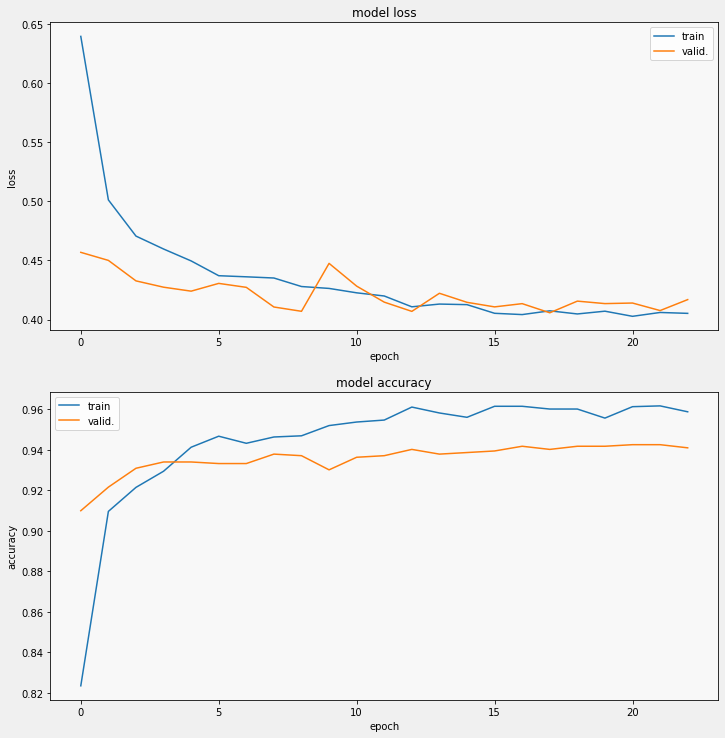

In [ ]:
display_training_curves(history_densenet.history['loss'], history_densenet.history['val_loss'], 'loss', 211)
display_training_curves(history_densenet.history['accuracy'], history_densenet.history['val_accuracy'], 'accuracy', 212)

In [ ]:
last_conv_layer_name = "conv5_block32_concat"
classifier_layer_names = [
    "bn",
    "relu",
    "averagepooling2d_head",
    "flatten_head",
    "dense_head",
    "dropout_head",
    "predictions_head"
]

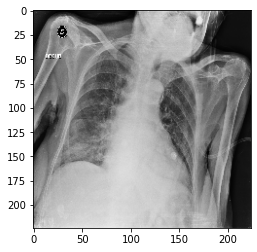

In [ ]:
# test image
file_path =  '/test/COVID19/COVID19(460).jpg'
test_image = cv2.imread(data_path + file_path)
test_image = cv2.resize(test_image, (224,224),interpolation=cv2.INTER_NEAREST)
plt.imshow(test_image)
test_image = np.expand_dims(test_image,axis=0)

In [ ]:
heatmap, top_index = make_gradcam_heatmap(test_image, model_densenet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index])

predicted as COVID19


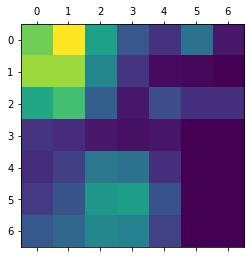

In [ ]:
plt.matshow(heatmap)
plt.show()

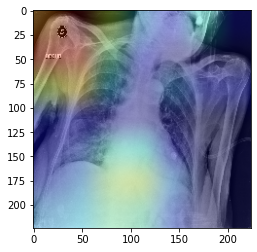

In [ ]:
s_img = superimposed_img(test_image[0], heatmap)
plt.imshow(s_img)

## confusion matrix

[[ 6  0  0]
 [ 0 18  0]
 [ 0  5 35]]
TP: 59
FP: 0
FN: 0
Precision: 1.0
Recall: 1.0
TP: 59
FP: 5
FN: 0
Precision: 0.921875
Recall: 1.0
TP: 59
FP: 0
FN: 5
Precision: 1.0
Recall: 0.921875
Precision and Recall Matrix: 
[[1.       1.      ]
 [0.921875 1.      ]
 [1.       0.921875]]
Total instances: 64
Accuracy: 0.921875


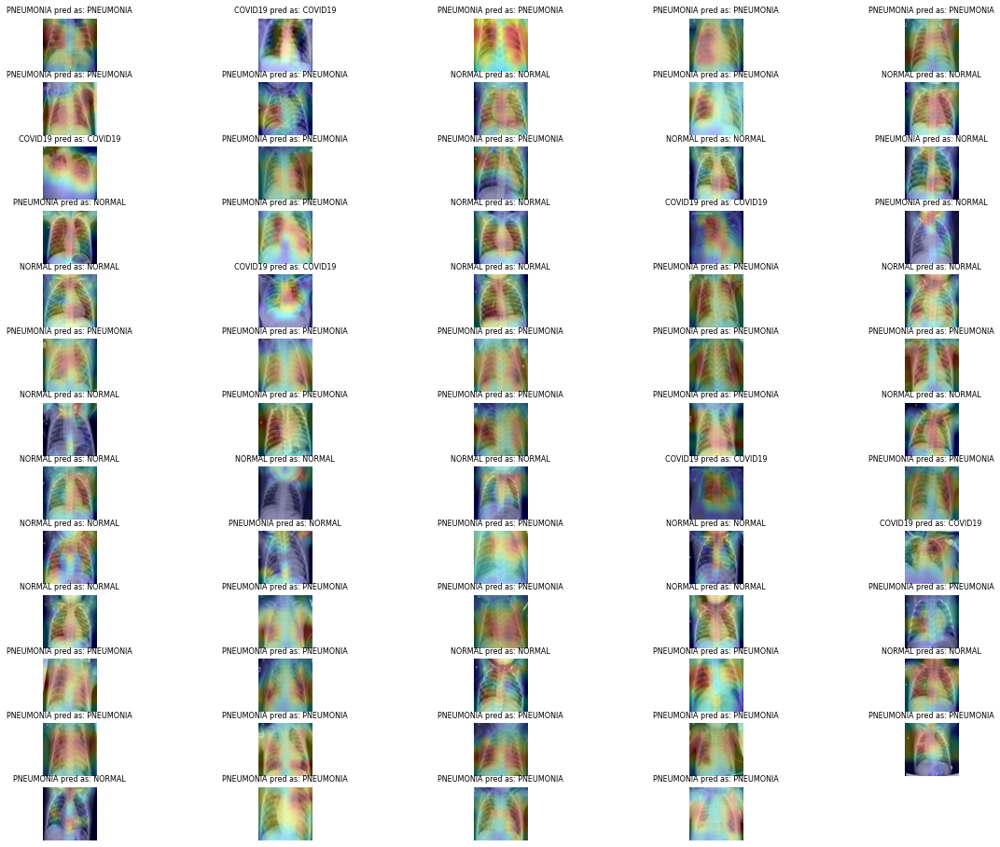

In [ ]:
# sample_data = testing_set.__getitem__(0)[0] 
# sample_label = testing_set.__getitem__(0)[1] 
cmatrix = np.zeros((3,3),dtype=int)
p_r_matrix = np.zeros((3,2),dtype=float)
plt.figure(figsize=(20,20))
for i in range(len(sample_data)):
    plt.subplot(16, 5, i+1)
    plt.axis('off')
    heatmap, top_index = make_gradcam_heatmap(np.expand_dims(sample_data[i], axis=0), model_densenet, last_conv_layer_name, classifier_layer_names)
    img = np.uint8(255 * sample_data[i])
    s_img = superimposed_img(img, heatmap)
    plt.imshow(s_img)
    plt.title(labels[np.argmax(sample_label[i])] + " pred as: " + labels[top_index], fontsize=8)
    row = np.argmax(sample_label[i])
    col = top_index
    cmatrix[row,col] = cmatrix[row,col]+1
print(cmatrix)

for i in range(p_r_matrix.shape[0]):
    recall = 0
    precision = 0
    TP = 0
    FP = 0
    FN = 0
    for j in range(cmatrix.shape[0]):
        TP = TP + cmatrix[j,j]
        if i is not j:
            FP = FP + cmatrix[j,i]
            FN = FN + cmatrix[i,j]
    print("TP: " + str(TP))
    print("FP: " + str(FP))
    print("FN: " + str(FN))
    precision = TP/(TP + FP)
    recall = TP/(TP + FN)
    p_r_matrix[i,0] = precision
    p_r_matrix[i,1] = recall
    print("Precision: " + str(precision))
    print("Recall: " + str(recall))
print("Precision and Recall Matrix: ")
print(p_r_matrix)

accuracy = 0
TP = 0
for i in range(cmatrix.shape[0]):
    TP = TP + cmatrix[i,i]
print("Total instances: " + str(np.sum(cmatrix)))
accuracy = TP/np.sum(cmatrix)
print("Accuracy: " + str(accuracy))

In [ ]:
evaluation = model_densenet.evaluate(testing_set, return_dict=True)

21/21 [==============================] - 29s 1s/step - loss: 0.4169 - accuracy: 0.9410 - precision: 0.9481 - recall: 0.9363


In [ ]:
# make predictions on the testing set
print("[INFO] evaluating network...")
print("densenet")
predIdxs = model_densenet.predict(sample_data, batch_size=BATCH_SIZE)
# for each image in the testing set we need to find the index of the
# label with corresponding largest predicted probability
predIdxs = np.argmax(predIdxs, axis=1)
# show a nicely formatted classification report
print(classification_report(sample_label.argmax(axis=1), predIdxs, 
                            target_names=labels))

[INFO] evaluating network...
densenet
              precision    recall  f1-score   support

     COVID19       1.00      1.00      1.00         6
      NORMAL       0.78      1.00      0.88        18
   PNEUMONIA       1.00      0.88      0.93        40

    accuracy                           0.92        64
   macro avg       0.93      0.96      0.94        64
weighted avg       0.94      0.92      0.92        64



In [ ]:
# compute the confusion matrix and and use it to derive the raw
# accuracy, sensitivity, and specificity
print("densenet")
cm = confusion_matrix(sample_label.argmax(axis=1), predIdxs)
total = sum(sum(cm))
acc = (cm[0, 0] + cm[1, 1]) / total
sensitivity = cm[0, 0] / (cm[0, 0] + cm[0, 1])
specificity = cm[1, 1] / (cm[1, 0] + cm[1, 1])
# show the confusion matrix, accuracy, sensitivity, and specificity
print(cm)
print("acc: {:.4f}".format(acc))
print("sensitivity: {:.4f}".format(sensitivity))
print("specificity: {:.4f}".format(specificity))

densenet
[[ 6  0  0]
 [ 0 18  0]
 [ 0  5 35]]
acc: 0.3750
sensitivity: 1.0000
specificity: 1.0000


## test CXR COVID

predicted as COVID19


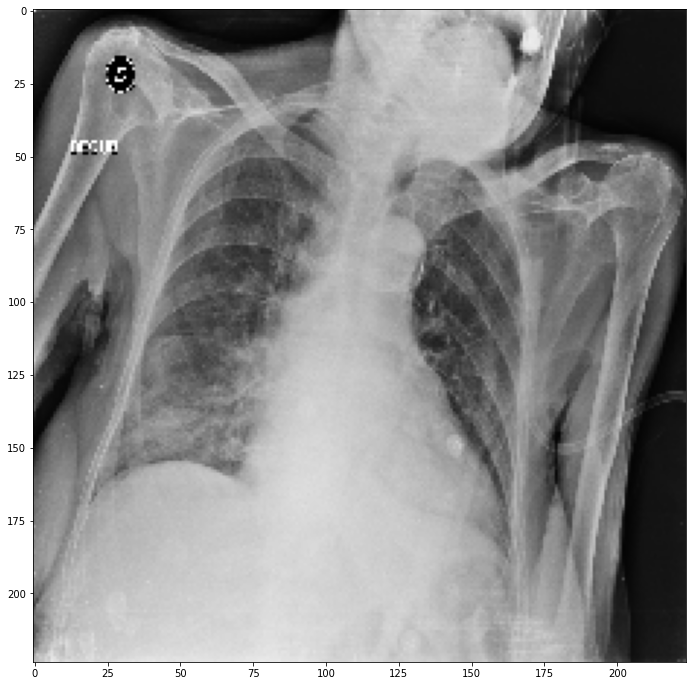

In [ ]:
# test image
file_path1 =  '/test/COVID19/COVID19(460).jpg'
test_image1 = cv2.imread(data_path + file_path1)
test_image1 = cv2.resize(test_image1, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image1)
test_image1 = np.expand_dims(test_image1,axis=0)

heatmap1, top_index1 = make_gradcam_heatmap(test_image1, model_densenet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index1])

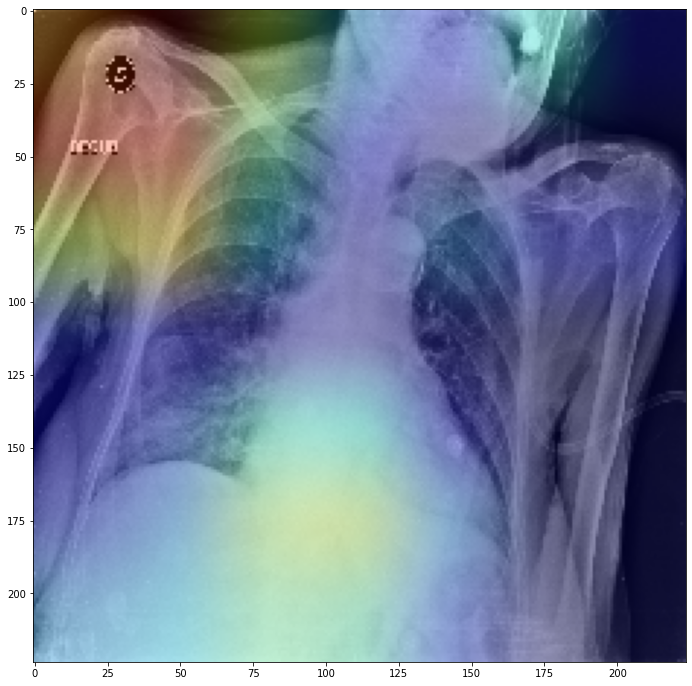

In [ ]:
s_img1 = superimposed_img(test_image1[0], heatmap1)
plt.figure(figsize=(15,12))
plt.imshow(s_img1)

predicted as COVID19


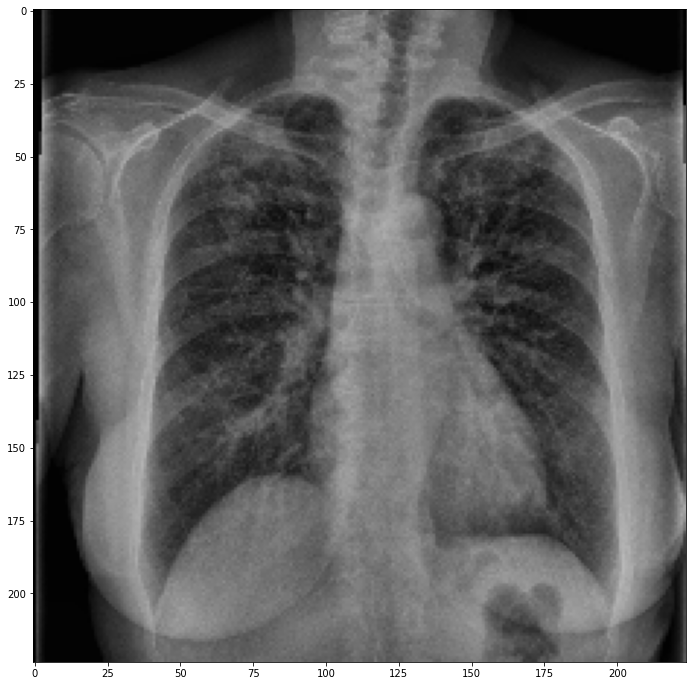

In [ ]:
# test image
file_path2 =  '/test/COVID19/COVID19(463).jpg'
test_image2 = cv2.imread(data_path + file_path2)
test_image2 = cv2.resize(test_image2, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image2)
test_image2 = np.expand_dims(test_image2,axis=0)

heatmap2, top_index2 = make_gradcam_heatmap(test_image2, model_densenet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index2])

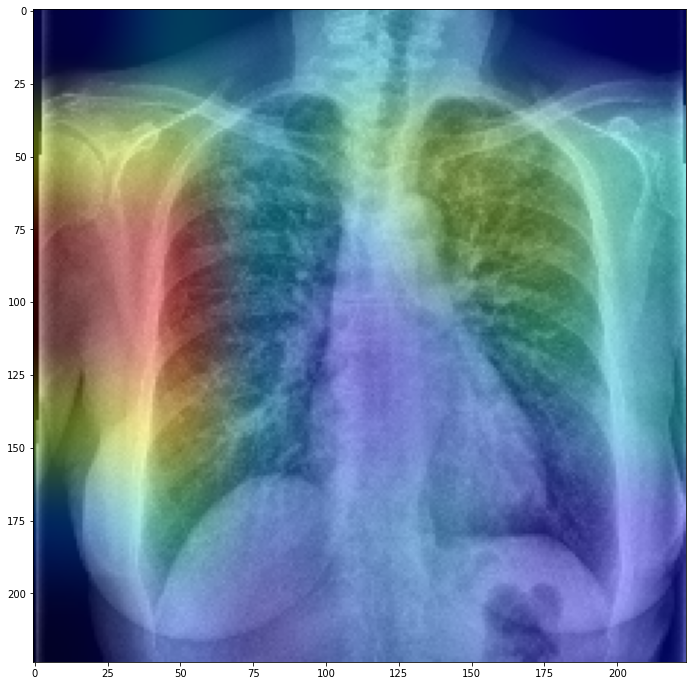

In [ ]:
s_img2 = superimposed_img(test_image2[0], heatmap2)
plt.figure(figsize=(15,12))
plt.imshow(s_img2)

predicted as COVID19


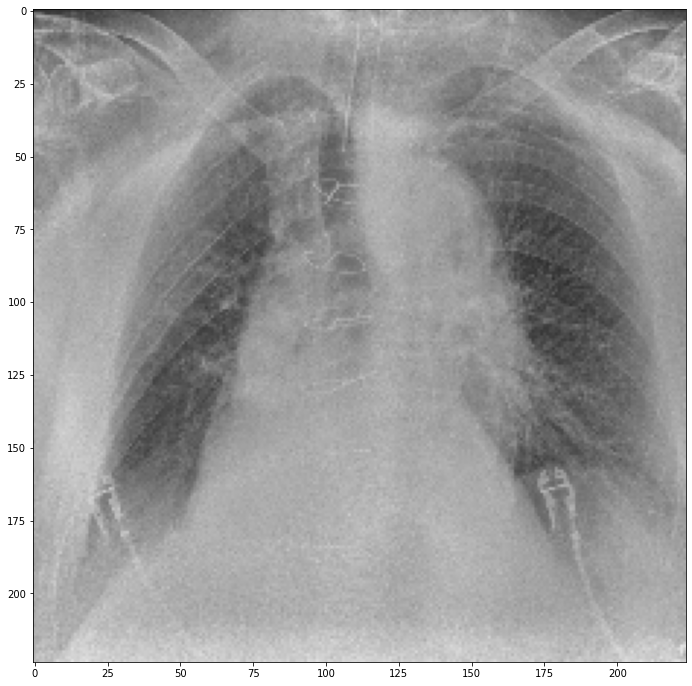

In [ ]:
# test image
file_path3 =  '/test/COVID19/COVID19(464).jpg'
test_image3 = cv2.imread(data_path + file_path3)
test_image3 = cv2.resize(test_image3, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image3)
test_image3 = np.expand_dims(test_image3,axis=0)

heatmap3, top_index3 = make_gradcam_heatmap(test_image3, model_densenet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index3])

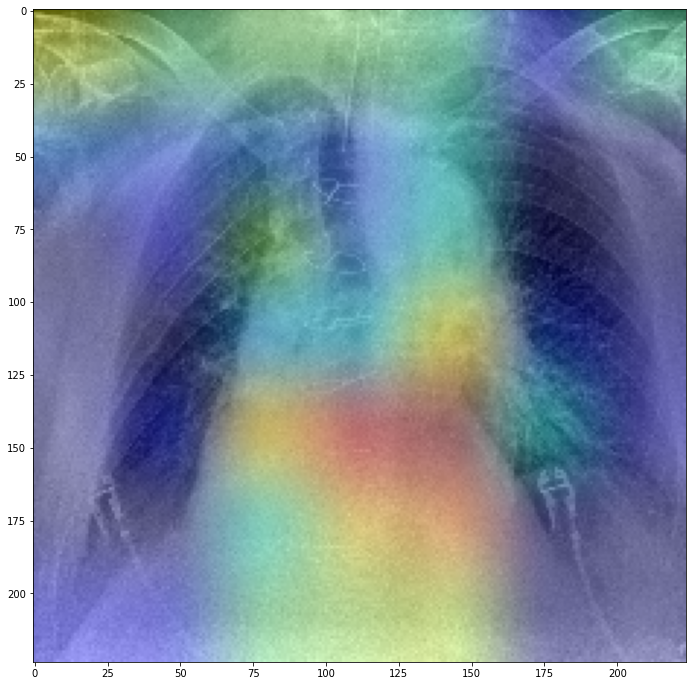

In [ ]:
s_img3 = superimposed_img(test_image3[0], heatmap3)
plt.figure(figsize=(15,12))
plt.imshow(s_img3)

predicted as COVID19


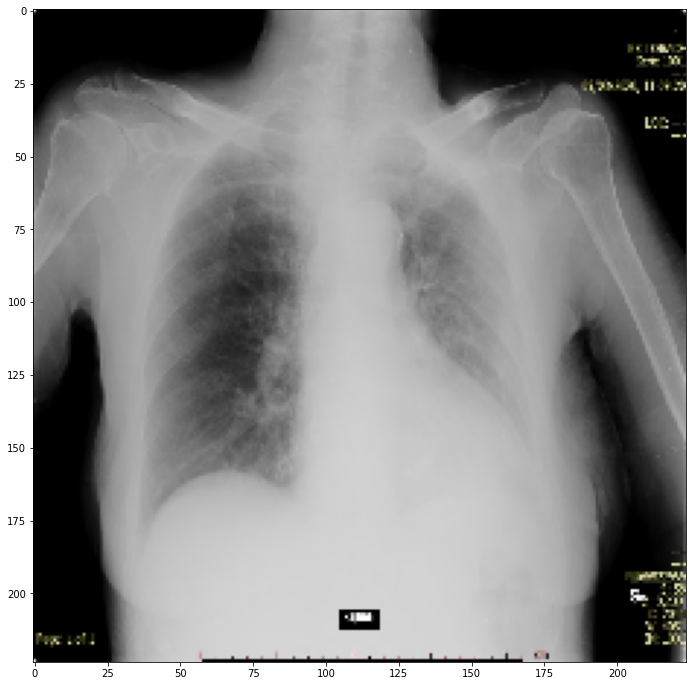

In [ ]:
# test image
file_path4 =  '/test/COVID19/COVID19(466).jpg'
test_image4 = cv2.imread(data_path + file_path4)
test_image4 = cv2.resize(test_image4, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image4)
test_image4 = np.expand_dims(test_image4,axis=0)

heatmap4, top_index4 = make_gradcam_heatmap(test_image4, model_densenet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index4])

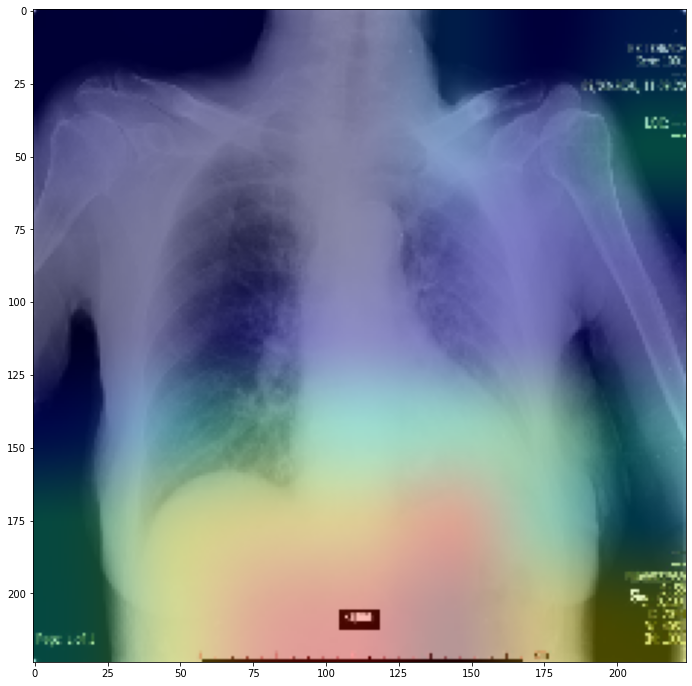

In [ ]:
s_img4 = superimposed_img(test_image4[0], heatmap4)
plt.figure(figsize=(15,12))
plt.imshow(s_img4)

predicted as COVID19


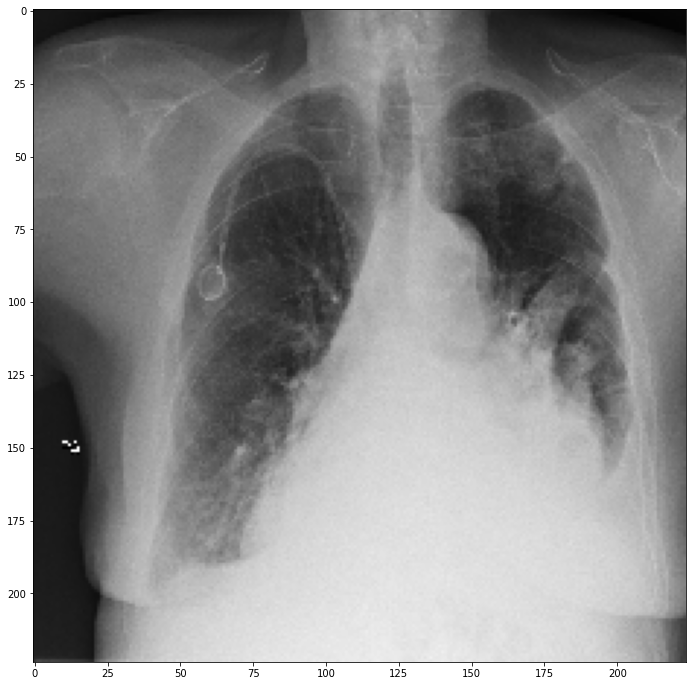

In [ ]:
# test image
file_path5 =  '/test/COVID19/COVID19(471).jpg'
test_image5 = cv2.imread(data_path + file_path5)
test_image5 = cv2.resize(test_image5, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image5)
test_image5 = np.expand_dims(test_image5,axis=0)

heatmap5, top_index5 = make_gradcam_heatmap(test_image5, model_densenet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index5])

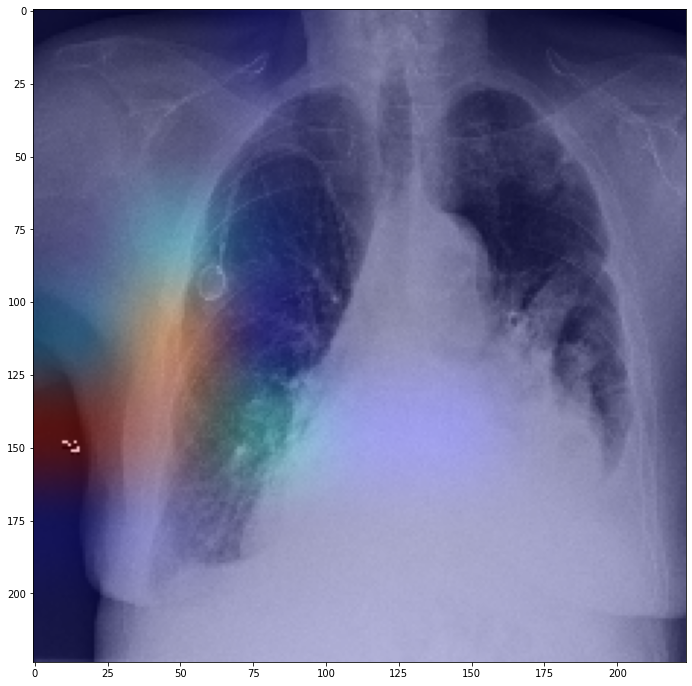

In [ ]:
s_img5 = superimposed_img(test_image5[0], heatmap5)
plt.figure(figsize=(15,12))
plt.imshow(s_img5)

## test CXR Normal

predicted as COVID19


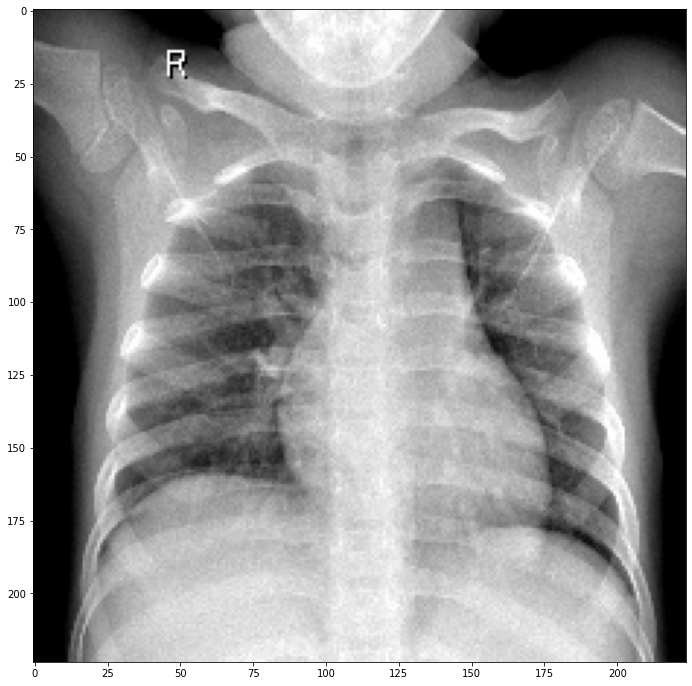

In [ ]:
# test image
file_path16 =  '/test/NORMAL/NORMAL(1267).jpg'
test_image16 = cv2.imread(data_path + file_path16)
test_image16 = cv2.resize(test_image16, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image16)
test_image16 = np.expand_dims(test_image16,axis=0)

heatmap16, top_index16 = make_gradcam_heatmap(test_image16, model_densenet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index16])

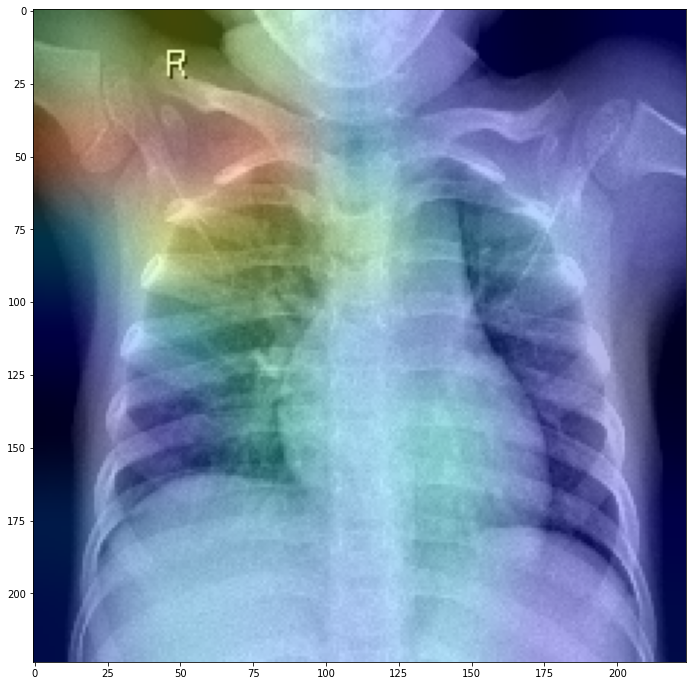

In [ ]:
s_img16 = superimposed_img(test_image16[0], heatmap16)
plt.figure(figsize=(15,12))
plt.imshow(s_img16)

ValueError: ignored

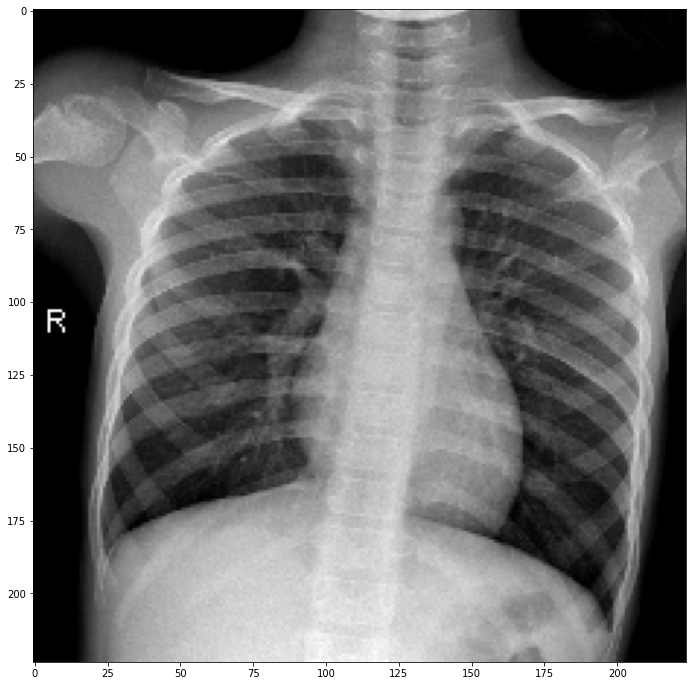

In [ ]:
# test image
file_path17 =  '/test/NORMAL/NORMAL(1270).jpg'
test_image17 = cv2.imread(data_path + file_path17)
test_image17 = cv2.resize(test_image17, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image17)
test_image3 = np.expand_dims(test_image17,axis=0)

heatmap17, top_index17 = make_gradcam_heatmap(test_image17, model_densenet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index17])

In [ ]:
s_img17 = superimposed_img(test_image17[0], heatmap17)
plt.figure(figsize=(15,12))
plt.imshow(s_img17)

NameError: ignored

predicted as COVID19


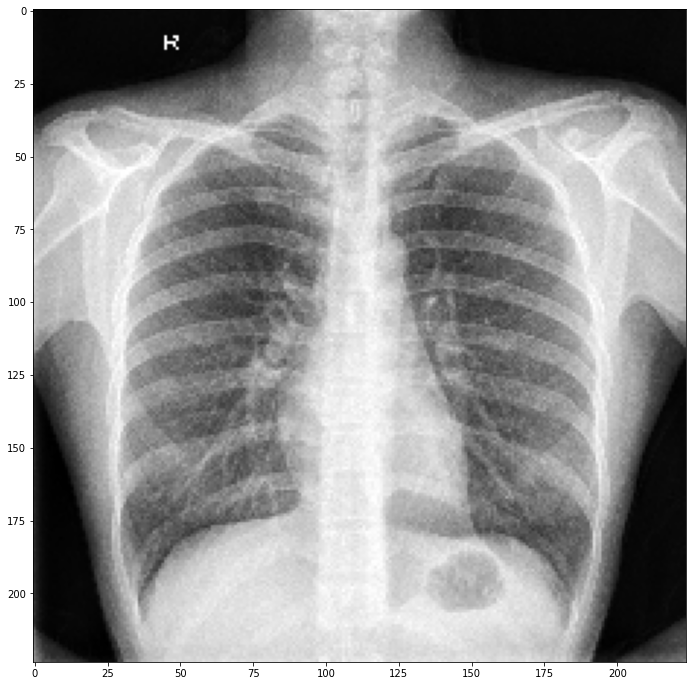

In [ ]:
# test image
file_path18 =  '/test/NORMAL/NORMAL(1283).jpg'
test_image18 = cv2.imread(data_path + file_path18)
test_image18 = cv2.resize(test_image18, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image18)
test_image18 = np.expand_dims(test_image18,axis=0)

heatmap18, top_index18 = make_gradcam_heatmap(test_image18, model_densenet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index18])

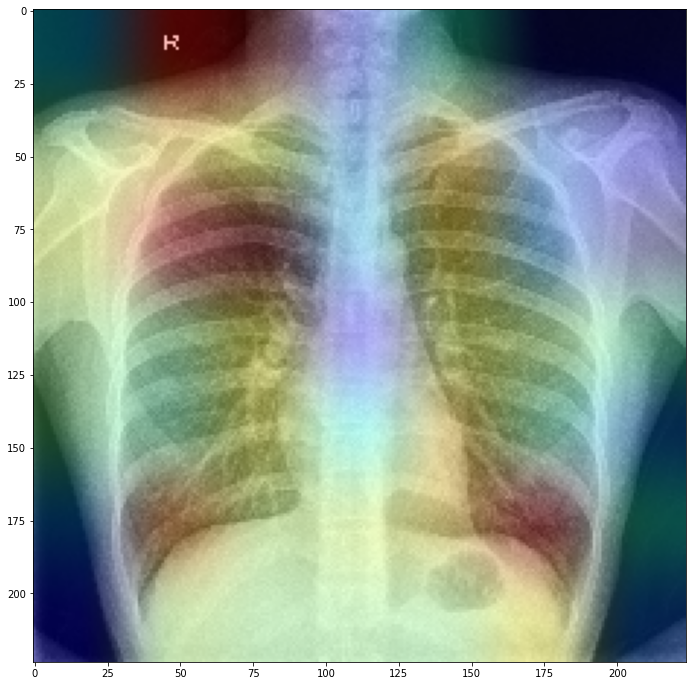

In [ ]:
s_img18 = superimposed_img(test_image18[0], heatmap18)
plt.figure(figsize=(15,12))
plt.imshow(s_img18)

ValueError: ignored

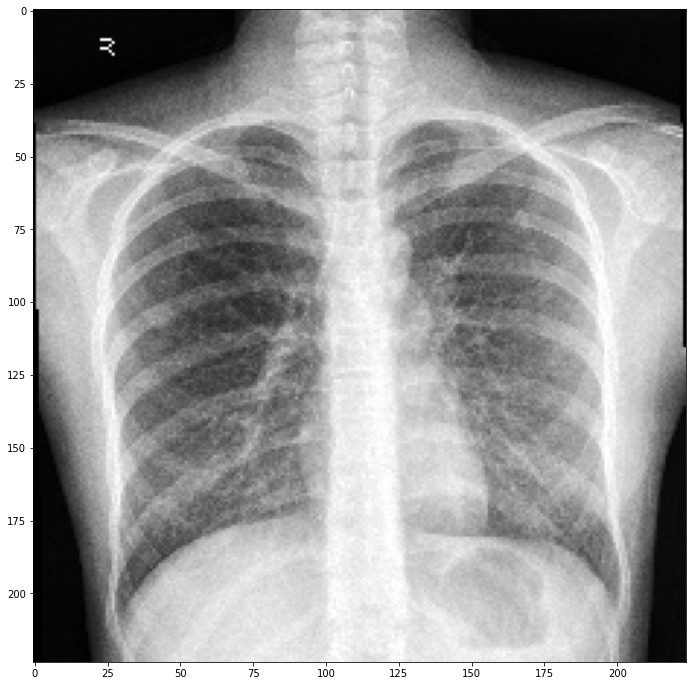

In [ ]:
# test image
file_path19 =  '/test/NORMAL/NORMAL(1299).jpg'
test_image19 = cv2.imread(data_path + file_path19)
test_image19 = cv2.resize(test_image19, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image19)
test_image3 = np.expand_dims(test_image3,axis=0)

heatmap19, top_index19 = make_gradcam_heatmap(test_image19, model_densenet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index19])

In [ ]:
s_img19 = superimposed_img(test_image19[0], heatmap19)
plt.figure(figsize=(15,12))
plt.imshow(s_img19)

NameError: ignored

predicted as COVID19


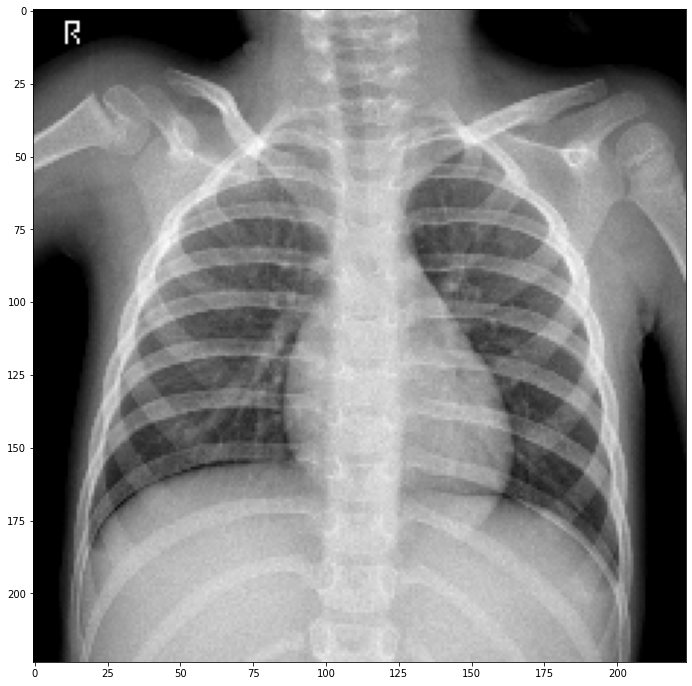

In [ ]:
# test image
file_path20 =  '/test/NORMAL/NORMAL(1309).jpg'
test_image20 = cv2.imread(data_path + file_path20)
test_image20 = cv2.resize(test_image20, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image20)
test_image20 = np.expand_dims(test_image20,axis=0)

heatmap20, top_index20 = make_gradcam_heatmap(test_image20, model_densenet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index20])

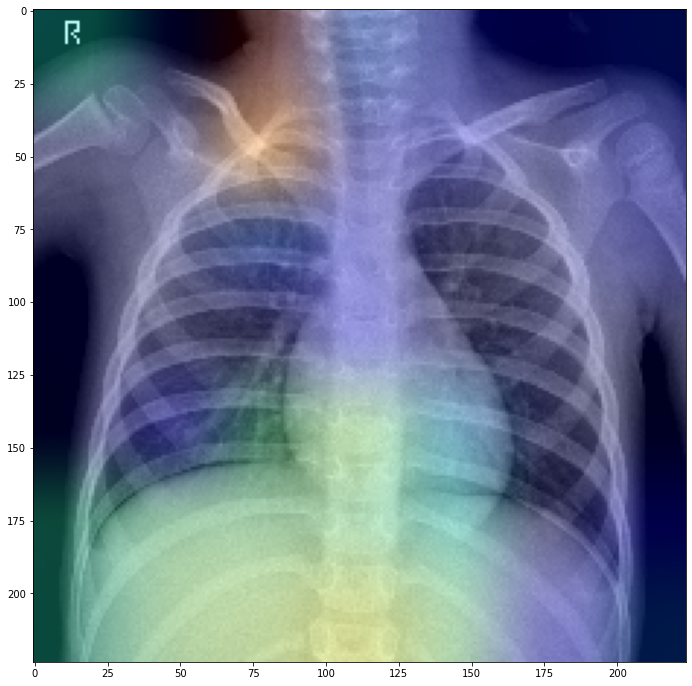

In [ ]:
s_img20 = superimposed_img(test_image20[0], heatmap20)
plt.figure(figsize=(15,12))
plt.imshow(s_img20)

## test CXR Pnuemonia

predicted as PNEUMONIA


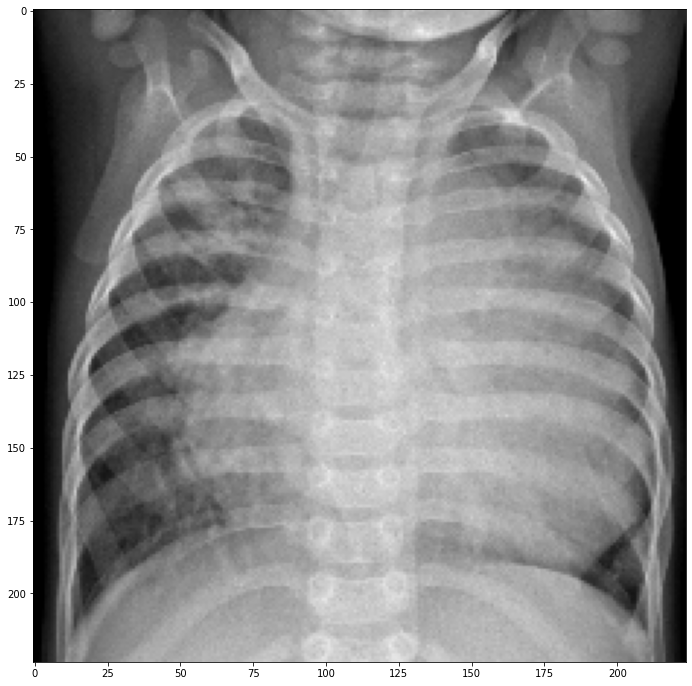

In [ ]:
# test image
file_path31 =  '/test/PNEUMONIA/PNEUMONIA(3419).jpg'
test_image31 = cv2.imread(data_path + file_path31)
test_image31 = cv2.resize(test_image31, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image31)
test_image31 = np.expand_dims(test_image31,axis=0)

heatmap31, top_index31 = make_gradcam_heatmap(test_image31, model_densenet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index31])

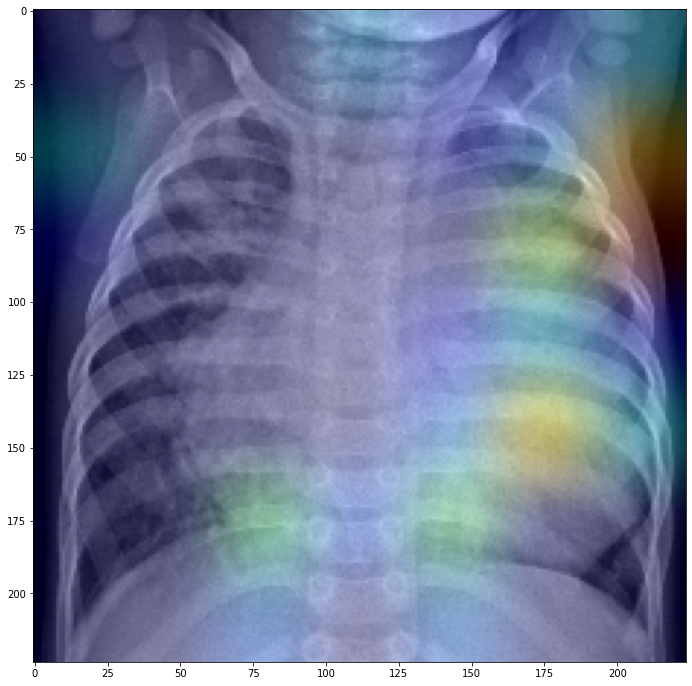

In [ ]:
s_img31 = superimposed_img(test_image31[0], heatmap31)
plt.figure(figsize=(15,12))
plt.imshow(s_img31)

predicted as COVID19


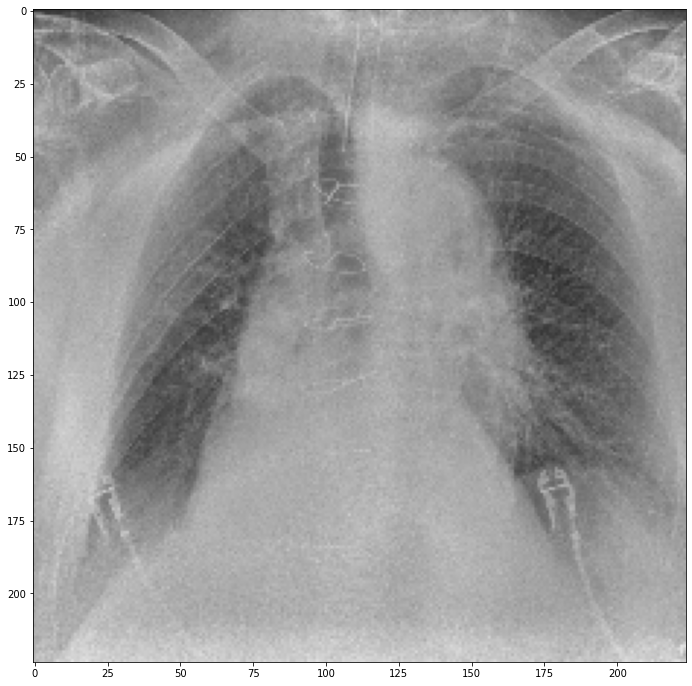

In [ ]:
# test image
file_path32 =  '/test/PNEUMONIA/PNEUMONIA(3420).jpg'
test_image32 = cv2.imread(data_path + file_path3)
test_image32 = cv2.resize(test_image32, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image32)
test_image32 = np.expand_dims(test_image32,axis=0)

heatmap32, top_index32 = make_gradcam_heatmap(test_image32, model_densenet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index32])

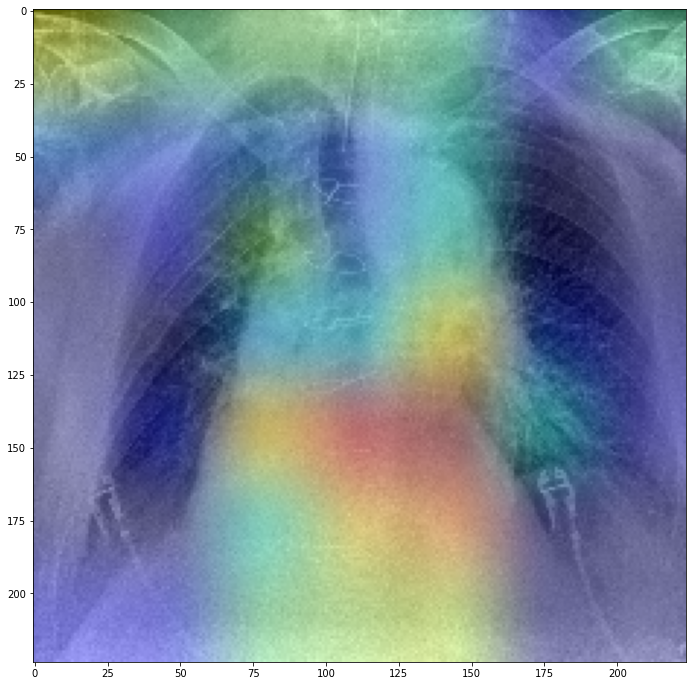

In [ ]:
s_img32 = superimposed_img(test_image32[0], heatmap32)
plt.figure(figsize=(15,12))
plt.imshow(s_img32)

predicted as COVID19


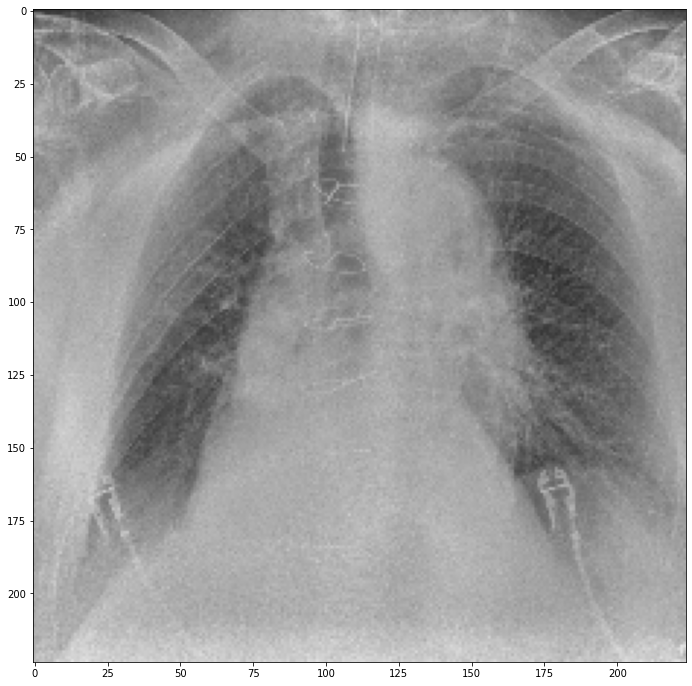

In [ ]:
# test image
file_path33 =  '/test/PNEUMONIA/PNEUMONIA(3455).jpg'
test_image33 = cv2.imread(data_path + file_path3)
test_image33 = cv2.resize(test_image33, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image33)
test_image33 = np.expand_dims(test_image33,axis=0)

heatmap33, top_index33 = make_gradcam_heatmap(test_image33, model_densenet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index33])

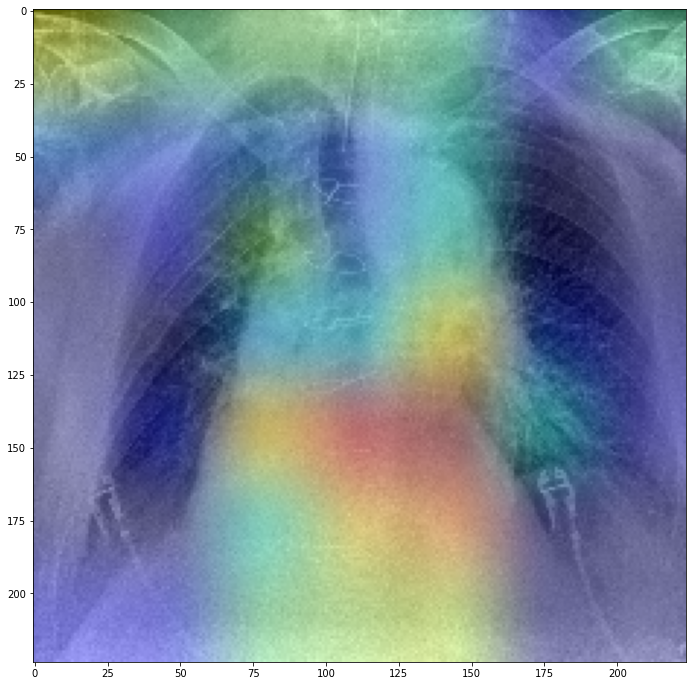

In [ ]:
s_img33 = superimposed_img(test_image33[0], heatmap33)
plt.figure(figsize=(15,12))
plt.imshow(s_img33)

predicted as COVID19


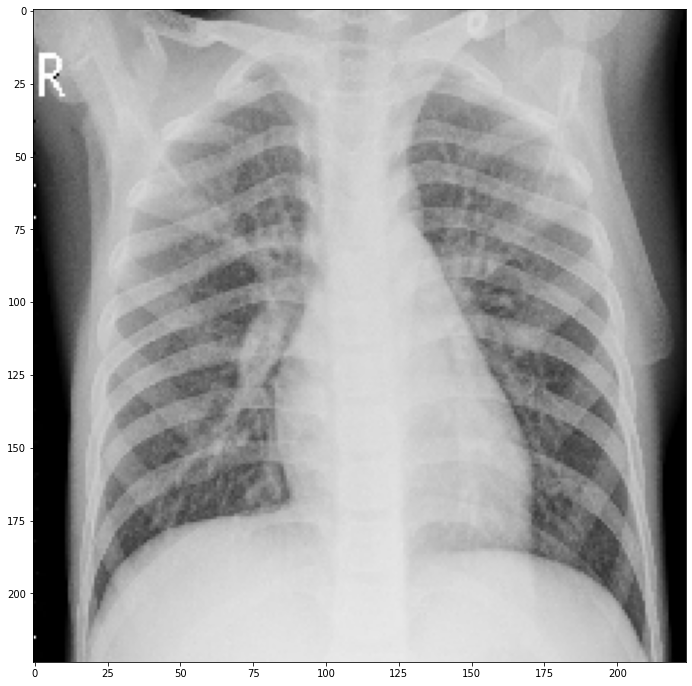

In [ ]:
# test image
file_path34 =  '/test/PNEUMONIA/PNEUMONIA(3466).jpg'
test_image34 = cv2.imread(data_path + file_path34)
test_image34 = cv2.resize(test_image34, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image34)
test_image34 = np.expand_dims(test_image34,axis=0)

heatmap34, top_index34 = make_gradcam_heatmap(test_image34, model_densenet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index34])

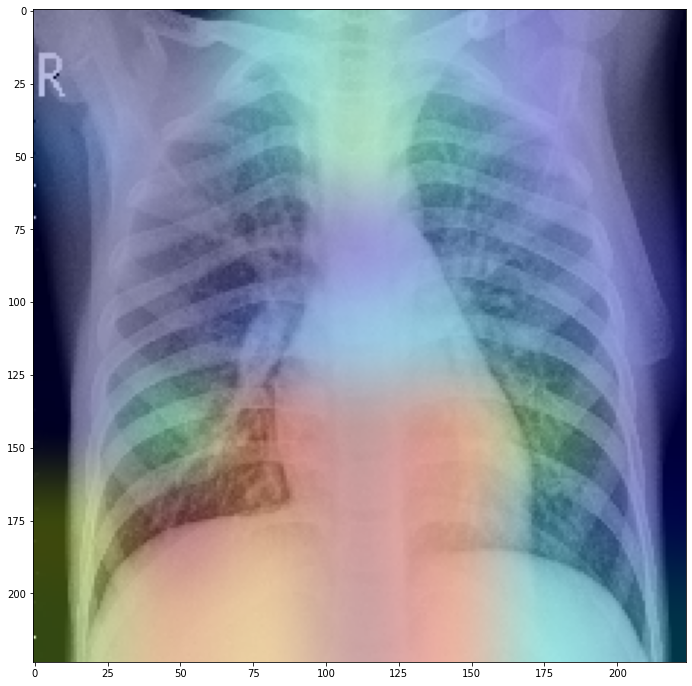

In [ ]:
s_img34 = superimposed_img(test_image34[0], heatmap34)
plt.figure(figsize=(15,12))
plt.imshow(s_img34)

predicted as COVID19


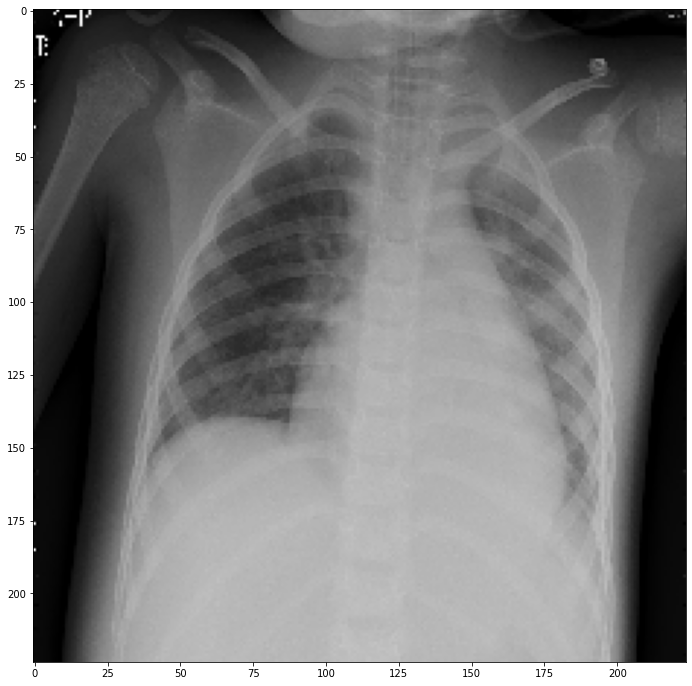

In [ ]:
# test image
file_path35 =  '/test/PNEUMONIA/PNEUMONIA(3555).jpg'
test_image35 = cv2.imread(data_path + file_path35)
test_image35 = cv2.resize(test_image35, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image35)
test_image35 = np.expand_dims(test_image35,axis=0)

heatmap35, top_index35 = make_gradcam_heatmap(test_image35, model_densenet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index35])

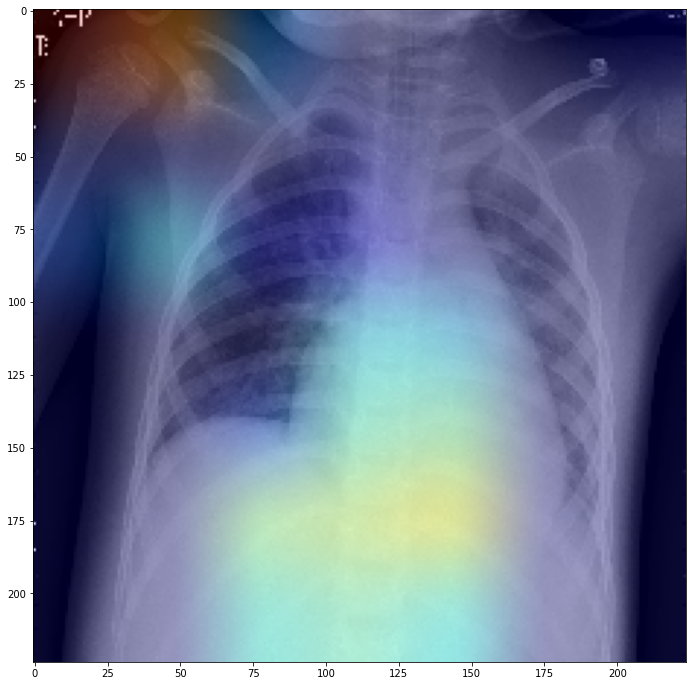

In [ ]:
s_img35 = superimposed_img(test_image35[0], heatmap35)
plt.figure(figsize=(15,12))
plt.imshow(s_img35)

# EfficiantNet

In [ ]:
from keras.callbacks import Callback,ModelCheckpoint
from keras.models import Sequential,load_model
from keras.layers import Dense, Dropout
from keras.wrappers.scikit_learn import KerasClassifier
import keras.backend as K

def get_f1(y_true, y_pred): #taken from old keras source code
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision = true_positives / (predicted_positives + K.epsilon())
    recall = true_positives / (possible_positives + K.epsilon())
    f1_val = 2*(precision*recall)/(precision+recall+K.epsilon())
    return f1_val

In [ ]:
# https://github.com/keras-team/keras/issues/9064
pretrained_efnet = efn.EfficientNetB7(input_shape=(image_size, image_size, 3), weights='noisy-student', include_top=False)

for layer in pretrained_efnet.layers:
  layer.trainable = False

x2 = pretrained_efnet.output
x2 = tf.keras.layers.AveragePooling2D(name="averagepooling2d_head")(x2)
x2 = tf.keras.layers.Flatten(name="flatten_head")(x2)
x2 = tf.keras.layers.Dense(64, activation="relu", name="dense_head")(x2)
x2 = tf.keras.layers.Dropout(0.5, name="dropout_head")(x2)
model_out = tf.keras.layers.Dense(3, activation='softmax', name="predictions_head")(x2)

model_efnet = Model(inputs=pretrained_efnet.input, outputs=model_out)
model_efnet.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),loss=categorical_smooth_loss,metrics=['accuracy',tf.keras.metrics.Precision(),tf.keras.metrics.Recall(),get_f1])
model_efnet.summary()

258072576/258068648 [==============================] - 4s 0us/step
Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
stem_conv (Conv2D)              (None, 112, 112, 64) 1728        input_5[0][0]                    
__________________________________________________________________________________________________
stem_bn (BatchNormalization)    (None, 112, 112, 64) 256         stem_conv[0][0]                  
__________________________________________________________________________________________________
stem_activation (Activation)    (None, 112, 112, 64) 0           stem_bn[0][0]                    
___________________________

In [ ]:
history_efnet = model_efnet.fit_generator(training_set, validation_data=testing_set, callbacks=[lr_reduce, es_callback], epochs=30)  

/usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/engine/training.py:1844: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Epoch 1/30
 4/81 [>.............................] - ETA: 33:53 - loss: 1.1437 - accuracy: 0.5514 - precision: 0.5816 - recall: 0.4095 - get_f1: 0.4734

In [ ]:
model_efnet.save("model_densenet_30_09596.h5")
print(history_efnet.history.keys())
# print(list(history_efnet.history.keys()))

In [ ]:
display_training_curves(history_efnet.history['loss'], history_efnet.history['val_loss'], 'loss', 211)
display_training_curves(history_efnet.history['accuracy'], history_efnet.history['val_accuracy'], 'accuracy', 212)

In [ ]:
display_training_curves(history_efnet.history['get_f1'], history_efnet.history['val_get_f1'], 'get_f1', 211)

In [ ]:
display_training_curves(history_efnet.history['recall_1'], history_efnet.history['val_recall_1'], 'recall', 211)
display_training_curves(history_efnet.history['precision_1'], history_efnet.history['val_precision_1'], 'precision', 212)

In [ ]:
last_conv_layer_name = "top_conv"
classifier_layer_names = [
    "top_bn",
    "top_activation",
    "averagepooling2d_head",
    "flatten_head",
    "dense_head",
    "dropout_head",
    "predictions_head"
]

## confusion matrix

In [ ]:
# sample_data = testing_set.__getitem__(0)[0] 
# sample_label = testing_set.__getitem__(0)[1] 
cmatrix = np.zeros((3,3),dtype=int)
p_r_matrix = np.zeros((3,2),dtype=float)
plt.figure(figsize=(20,20))
for i in range(len(sample_data)):
    plt.subplot(16, 5, i+1)
    plt.axis('off')
    heatmap, top_index = make_gradcam_heatmap(np.expand_dims(sample_data[i], axis=0), model_efnet, last_conv_layer_name, classifier_layer_names)
    img = np.uint8(255 * sample_data[i])
    s_img = superimposed_img(img, heatmap)
    plt.imshow(s_img)
    plt.title(labels[np.argmax(sample_label[i])] + " pred as: " + labels[top_index], fontsize=8)
    row = np.argmax(sample_label[i])
    col = top_index
    cmatrix[row,col] = cmatrix[row,col]+1
print(cmatrix)

for i in range(p_r_matrix.shape[0]):
    recall = 0
    precision = 0
    TP = 0
    FP = 0
    FN = 0
    for j in range(cmatrix.shape[0]):
        TP = TP + cmatrix[j,j]
        if i is not j:
            FP = FP + cmatrix[j,i]
            FN = FN + cmatrix[i,j]
    print("TP: " + str(TP))
    print("FP: " + str(FP))
    print("FN: " + str(FN))
    precision = TP/(TP + FP)
    recall = TP/(TP + FN)
    p_r_matrix[i,0] = precision
    p_r_matrix[i,1] = recall
    print("Precision: " + str(precision))
    print("Recall: " + str(recall))
print("Precision and Recall Matrix: ")
print(p_r_matrix)

accuracy = 0
TP = 0
for i in range(cmatrix.shape[0]):
    TP = TP + cmatrix[i,i]
print("Total instances: " + str(np.sum(cmatrix)))
accuracy = TP/np.sum(cmatrix)
print("Accuracy: " + str(accuracy))

In [ ]:
evaluation = model_efnet.evaluate(testing_set, return_dict=True)

In [ ]:
# make predictions on the testing set
print("[INFO] evaluating network...")
print("model_efnet")
predIdxs1 = model_efnet.predict(sample_data, batch_size=BATCH_SIZE)
# for each image in the testing set we need to find the index of the
# label with corresponding largest predicted probability
predIdxs1 = np.argmax(predIdxs1, axis=1)
# show a nicely formatted classification report
print(classification_report(sample_label.argmax(axis=1), predIdxs1, 
                            target_names=labels))


In [ ]:
# compute the confusion matrix and and use it to derive the raw
# accuracy, sensitivity, and specificity
print("model_efnet")
cm = confusion_matrix(sample_label.argmax(axis=1), predIdxs1)
total = sum(sum(cm))
acc = (cm[0, 0] + cm[1, 1]) / total
sensitivity = cm[0, 0] / (cm[0, 0] + cm[0, 1])
specificity = cm[1, 1] / (cm[1, 0] + cm[1, 1])
# show the confusion matrix, accuracy, sensitivity, and specificity
print(cm)
print("acc: {:.4f}".format(acc))
print("sensitivity: {:.4f}".format(sensitivity))
print("specificity: {:.4f}".format(specificity))


## test CXR COVID

In [ ]:
# test image
file_path1 =  '/test/COVID19/COVID19(460).jpg'
test_image1 = cv2.imread(data_path + file_path1)
test_image1 = cv2.resize(test_image1, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image1)
test_image1 = np.expand_dims(test_image1,axis=0)

heatmap1, top_index1 = make_gradcam_heatmap(test_image1, model_efnet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index1])


In [ ]:
s_img1 = superimposed_img(test_image1[0], heatmap1)
plt.figure(figsize=(15,12))
plt.imshow(s_img1)

In [ ]:
# test image
file_path2 =  '/test/COVID19/COVID19(463).jpg'
test_image2 = cv2.imread(data_path + file_path2)
test_image2 = cv2.resize(test_image2, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image2)
test_image2 = np.expand_dims(test_image2,axis=0)

heatmap2, top_index2 = make_gradcam_heatmap(test_image2, model_efnet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index2])

In [ ]:
s_img2 = superimposed_img(test_image2[0], heatmap2)
plt.figure(figsize=(15,12))
plt.imshow(s_im2)


In [ ]:
# test image
file_path3 =  '/test/COVID19/COVID19(464).jpg'
test_image3 = cv2.imread(data_path + file_path3)
test_image3 = cv2.resize(test_image3, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image3)
test_image3 = np.expand_dims(test_image3,axis=0)

heatmap3, top_index3 = make_gradcam_heatmap(test_image3, model_efnet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index3])


In [ ]:
s_img3 = superimposed_img(test_image3[0], heatmap3)
plt.figure(figsize=(15,12))
plt.imshow(s_img3)


In [ ]:
# test image
file_path4 =  '/test/COVID19/COVID19(466).jpg'
test_image4 = cv2.imread(data_path + file_path4)
test_image4 = cv2.resize(test_image4, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image4)
test_image4 = np.expand_dims(test_image4,axis=0)

heatmap4, top_index4 = make_gradcam_heatmap(test_image4, model_efnet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index4])


In [ ]:
s_img4 = superimposed_img(test_image4[0], heatmap4)
plt.figure(figsize=(15,12))
plt.imshow(s_img4)


In [ ]:
# test image
file_path5 =  '/test/COVID19/COVID19(471).jpg'
test_image5 = cv2.imread(data_path + file_path5)
test_image5 = cv2.resize(test_image5, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image5)
test_image5 = np.expand_dims(test_image5,axis=0)

heatmap5, top_index5 = make_gradcam_heatmap(test_image5, model_efnet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index5])


In [ ]:
s_img5 = superimposed_img(test_image5[0], heatmap5)
plt.figure(figsize=(15,12))
plt.imshow(s_img5)


## test CXR Normal

In [ ]:
# test image
file_path16 =  '/test/NORMAL/NORMAL(1267).jpg'
test_image16 = cv2.imread(data_path + file_path16)
test_image16 = cv2.resize(test_image16, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image16)
test_image16 = np.expand_dims(test_image16,axis=0)

heatmap16, top_index16 = make_gradcam_heatmap(test_image16, model_efnet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index16])


In [ ]:
s_img16 = superimposed_img(test_image16[0], heatmap16)
plt.figure(figsize=(15,12))
plt.imshow(s_img16)


In [ ]:
# test image
file_path17 =  '/test/NORMAL/NORMAL(1270).jpg'
test_image17 = cv2.imread(data_path + file_path17)
test_image17 = cv2.resize(test_image17, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image17)
test_image3 = np.expand_dims(test_image17,axis=0)

heatmap17, top_index17 = make_gradcam_heatmap(test_image17, model_efnet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index17])


In [ ]:
s_img17 = superimposed_img(test_image17[0], heatmap17)
plt.figure(figsize=(15,12))
plt.imshow(s_img17)


In [ ]:
# test image
file_path18 =  '/test/NORMAL/NORMAL(1283).jpg'
test_image18 = cv2.imread(data_path + file_path18)
test_image18 = cv2.resize(test_image18, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image18)
test_image18 = np.expand_dims(test_image18,axis=0)

heatmap18, top_index18 = make_gradcam_heatmap(test_image18, model_efnet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index18])


In [ ]:
s_img18 = superimposed_img(test_image18[0], heatmap18)
plt.figure(figsize=(15,12))
plt.imshow(s_img18)


In [ ]:
# test image
file_path19 =  '/test/NORMAL/NORMAL(1299).jpg'
test_image19 = cv2.imread(data_path + file_path19)
test_image19 = cv2.resize(test_image19, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image19)
test_image3 = np.expand_dims(test_image3,axis=0)

heatmap19, top_index19 = make_gradcam_heatmap(test_image19, model_efnet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index19])


In [ ]:
s_img19 = superimposed_img(test_image19[0], heatmap19)
plt.figure(figsize=(15,12))
plt.imshow(s_img19)


In [ ]:
# test image
file_path20 =  '/test/NORMAL/NORMAL(1309).jpg'
test_image20 = cv2.imread(data_path + file_path20)
test_image20 = cv2.resize(test_image20, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image20)
test_image20 = np.expand_dims(test_image20,axis=0)

heatmap20, top_index20 = make_gradcam_heatmap(test_image20, model_efnet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index20])


In [ ]:
s_img20 = superimposed_img(test_image20[0], heatmap20)
plt.figure(figsize=(15,12))
plt.imshow(s_img20)


## test CXR Pnuemonia

In [ ]:
# test image
file_path31 =  '/test/PNEUMONIA/PNEUMONIA(460).jpg'
test_image31 = cv2.imread(data_path + file_path31)
test_image31 = cv2.resize(test_image31, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image31)
test_image31 = np.expand_dims(test_image31,axis=0)

heatmap31, top_index31 = make_gradcam_heatmap(test_image31, model_efnet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index31])


In [ ]:
s_img31 = superimposed_img(test_image31[0], heatmap31)
plt.figure(figsize=(15,12))
plt.imshow(s_img31)


In [ ]:
# test image
file_path32 =  '/test/PNEUMONIA/PNEUMONIA(460).jpg'
test_image32 = cv2.imread(data_path + file_path3)
test_image32 = cv2.resize(test_image32, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image32)
test_image32 = np.expand_dims(test_image32,axis=0)

heatmap32, top_index32 = make_gradcam_heatmap(test_image32, model_efnet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index32])


In [ ]:
s_img32 = superimposed_img(test_image32[0], heatmap32)
plt.figure(figsize=(15,12))
plt.imshow(s_img32)


In [ ]:
# test image
file_path33 =  '/test/PNEUMONIA/PNEUMONIA(460).jpg'
test_image33 = cv2.imread(data_path + file_path3)
test_image33 = cv2.resize(test_image33, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image33)
test_image33 = np.expand_dims(test_image33,axis=0)

heatmap33, top_index33 = make_gradcam_heatmap(test_image3, model_efnet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index33])


In [ ]:
s_img33 = superimposed_img(test_image33[0], heatmap33)
plt.figure(figsize=(15,12))
plt.imshow(s_img33)


In [ ]:
# test image
file_path34 =  '/test/PNEUMONIA/PNEUMONIA(460).jpg'
test_image34 = cv2.imread(data_path + file_path34)
test_image34 = cv2.resize(test_image34, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image34)
test_image34 = np.expand_dims(test_image34,axis=0)

heatmap34, top_index34 = make_gradcam_heatmap(test_image34, model_efnet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index34])


In [ ]:
s_img34 = superimposed_img(test_image34[0], heatmap34)
plt.figure(figsize=(15,12))
plt.imshow(s_img34)

In [ ]:
# test image
file_path35 =  '/test/PNEUMONIA/PNEUMONIA(460).jpg'
test_image35 = cv2.imread(data_path + file_path35)
test_image35 = cv2.resize(test_image35, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image35)
test_image35 = np.expand_dims(test_image35,axis=0)

heatmap35, top_index35 = make_gradcam_heatmap(test_image35, model_efnet, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index35])


In [ ]:
s_img35 = superimposed_img(test_image35[0], heatmap35)
plt.figure(figsize=(15,12))
plt.imshow(s_img35)

# VGG16

In [ ]:
pretrained_vgg16 = tf.keras.applications.VGG16(input_shape=(image_size, image_size, 3), weights='imagenet', include_top=False)
 
for layer in pretrained_vgg16.layers:
  layer.trainable = False
 
x3 = pretrained_vgg16.output
x3 = tf.keras.layers.AveragePooling2D(name="averagepooling2d_head")(x3)
x3 = tf.keras.layers.Flatten(name="flatten_head")(x3)
x3 = tf.keras.layers.Dense(64, activation="relu", name="dense_head")(x3)
x3 = tf.keras.layers.Dropout(0.5, name="dropout_head")(x3)
model_out = tf.keras.layers.Dense(3, activation='softmax', name="predictions_head")(x3)
 
model_vgg16 = Model(inputs=pretrained_vgg16.input, outputs=model_out)
model_vgg16.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),loss=categorical_smooth_loss,metrics=['accuracy',tf.keras.metrics.Precision(),tf.keras.metrics.Recall()])
 
model_vgg16.summary()

58892288/58889256 [==============================] - 0s 0us/step
Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
______________________________________________________________

In [ ]:
history_vgg16 = model_vgg16.fit_generator(training_set, validation_data=testing_set, callbacks=[lr_reduce, es_callback], epochs=30)   

/usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/engine/training.py:1844: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Epoch 1/30
81/81 [==============================] - 1988s 25s/step - loss: 0.9260 - accuracy: 0.6159 - precision: 0.6581 - recall: 0.5227 - val_loss: 0.5966 - val_accuracy: 0.8191 - val_precision: 0.8542 - val_recall: 0.7958
Epoch 2/30
81/81 [==============================] - 193s 2s/step - loss: 0.6290 - accuracy: 0.8167 - precision: 0.8547 - recall: 0.7544 - val_loss: 0.5162 - val_accuracy: 0.8696 - val_precision: 0.8898 - val_recall: 0.8401
Epoch 3/30
81/81 [==============================] - 191s 2s/step - loss: 0.5694 - accuracy: 0.8597 - precision: 0.8850 - recall: 0.8102 - val_loss: 0.4948 - val_accuracy: 0.8890 - val_precision: 0.8990 - val_recall: 0.8703
Epoch 4/30
81/81 [==============================] - 190s 2s/step - loss: 0.5316 - accuracy: 0.8866 - precision: 0.9034 - recall: 0.8469 - val_loss: 0.4956 - val_accuracy: 0.8843 - val_precision: 0.8914 - val_recall: 0.8727
Epoch 5/30
81/81 [==============================] - 189s 2s/step - loss: 0.5053 - accuracy: 0.9020 - preci

In [ ]:
print(history_vgg16.history.keys())
model_vgg16.save("model_vgg16_30_09996.h5")

dict_keys(['loss', 'accuracy', 'precision', 'recall', 'val_loss', 'val_accuracy', 'val_precision', 'val_recall', 'lr'])


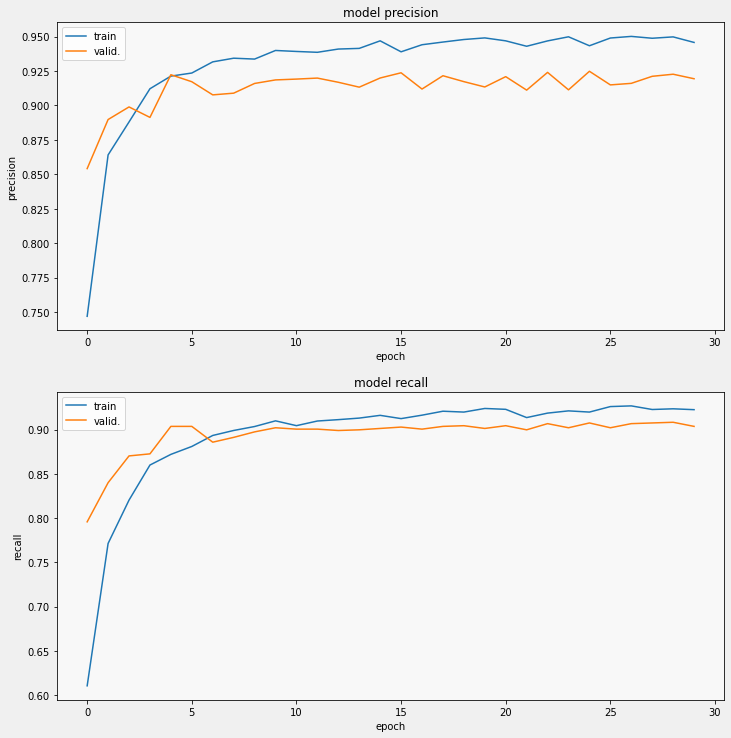

In [ ]:
display_training_curves(history_vgg16.history['precision'], history_vgg16.history['val_precision'], 'precision', 211)
display_training_curves(history_vgg16.history['recall'], history_vgg16.history['val_recall'], 'recall', 212)

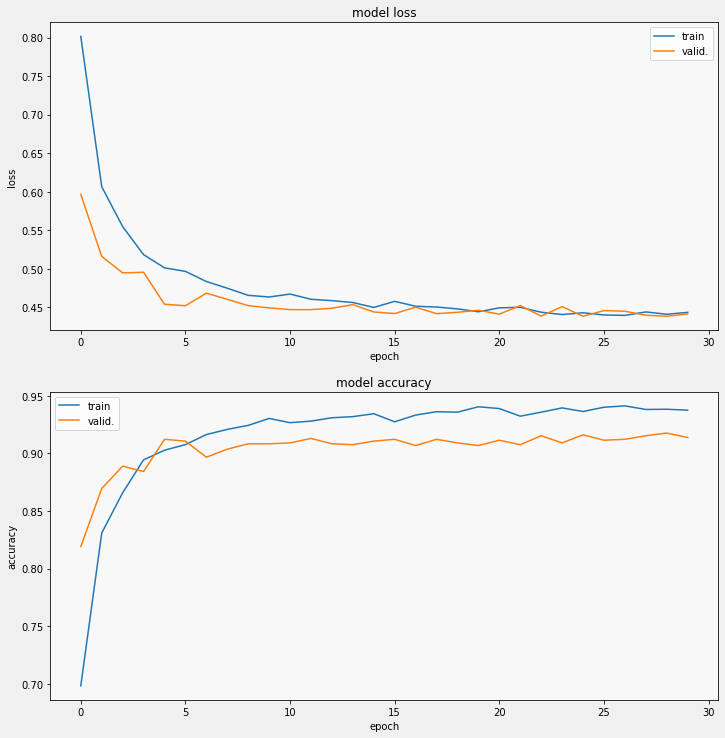

In [ ]:
display_training_curves(history_vgg16.history['loss'], history_vgg16.history['val_loss'], 'loss', 211)
display_training_curves(history_vgg16.history['accuracy'], history_vgg16.history['val_accuracy'], 'accuracy', 212)

In [ ]:
last_conv_layer_name = "block5_conv3"
classifier_layer_names = [
    "block5_pool",
    "averagepooling2d_head",
    "flatten_head",
    "dense_head",
    "dropout_head",
    "predictions_head"
]

## confusion matrix



[[10  0  0]
 [ 0  8  1]
 [ 0  2 43]]
TP: 61
FP: 0
FN: 0
Precision: 1.0
Recall: 1.0
TP: 61
FP: 2
FN: 1
Precision: 0.9682539682539683
Recall: 0.9838709677419355
TP: 61
FP: 1
FN: 2
Precision: 0.9838709677419355
Recall: 0.9682539682539683
Precision and Recall Matrix: 
[[1.         1.        ]
 [0.96825397 0.98387097]
 [0.98387097 0.96825397]]
Total instances: 64
Accuracy: 0.953125


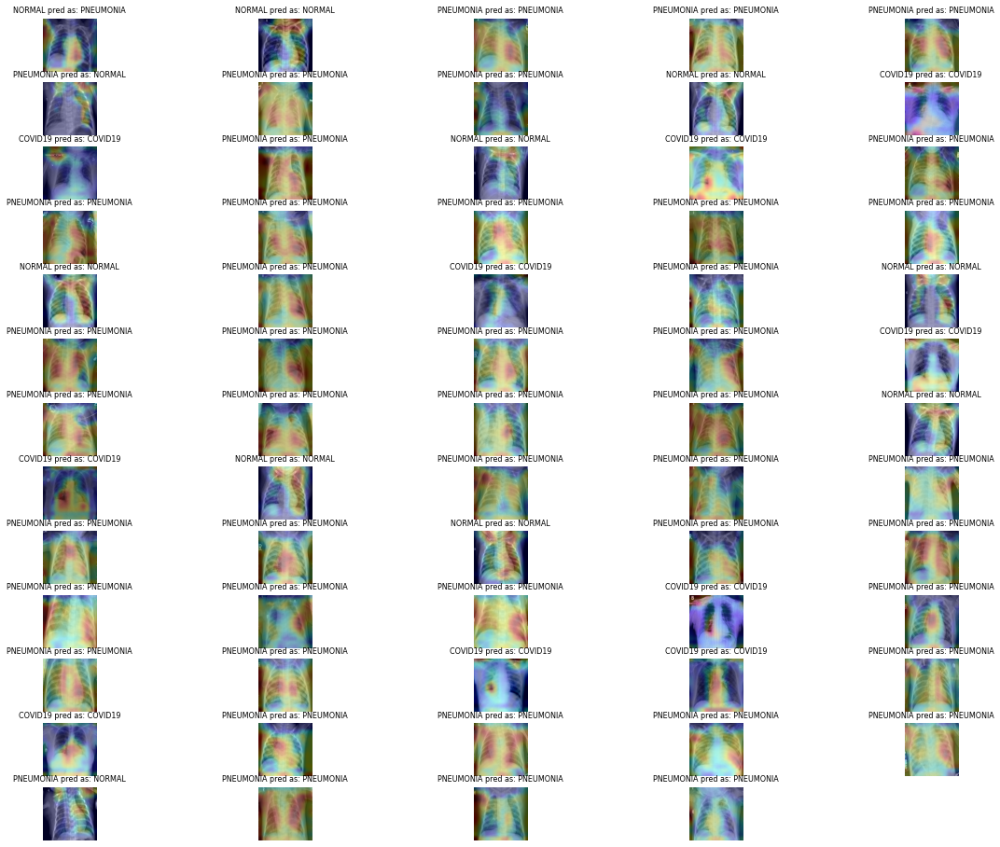

In [ ]:
cmatrix = np.zeros((3,3),dtype=int)
p_r_matrix = np.zeros((3,2),dtype=float)
plt.figure(figsize=(20,20))
for i in range(len(sample_data)):
    plt.subplot(16, 5, i+1)
    plt.axis('off')
    heatmap, top_index = make_gradcam_heatmap(np.expand_dims(sample_data[i], axis=0), model_vgg16, last_conv_layer_name, classifier_layer_names)
    img = np.uint8(255 * sample_data[i])
    s_img = superimposed_img(img, heatmap)
    plt.imshow(s_img)
    plt.title(labels[np.argmax(sample_label[i])] + " pred as: " + labels[top_index], fontsize=8)
    row = np.argmax(sample_label[i])
    col = top_index
    cmatrix[row,col] = cmatrix[row,col]+1
print(cmatrix)

for i in range(p_r_matrix.shape[0]):
    recall = 0
    precision = 0
    TP = 0
    FP = 0
    FN = 0
    for j in range(cmatrix.shape[0]):
        TP = TP + cmatrix[j,j]
        if i is not j:
            FP = FP + cmatrix[j,i]
            FN = FN + cmatrix[i,j]
    print("TP: " + str(TP))
    print("FP: " + str(FP))
    print("FN: " + str(FN))
    precision = TP/(TP + FP)
    recall = TP/(TP + FN)
    p_r_matrix[i,0] = precision
    p_r_matrix[i,1] = recall
    print("Precision: " + str(precision))
    print("Recall: " + str(recall))
print("Precision and Recall Matrix: ")
print(p_r_matrix)

accuracy = 0
TP = 0
for i in range(cmatrix.shape[0]):
    TP = TP + cmatrix[i,i]
print("Total instances: " + str(np.sum(cmatrix)))
accuracy = TP/np.sum(cmatrix)
print("Accuracy: " + str(accuracy))

In [ ]:
evaluation = model_vgg16.evaluate(testing_set, return_dict=True)

21/21 [==============================] - 29s 1s/step - loss: 0.4416 - accuracy: 0.9138 - precision: 0.9194 - recall: 0.9037


In [ ]:
# make predictions on the testing set
print("[INFO] evaluating network...")
print("vgg16")
predIdxs2 = model_vgg16.predict(sample_data, batch_size=BATCH_SIZE)
# for each image in the testing set we need to find the index of the
# label with corresponding largest predicted probability
predIdxs2 = np.argmax(predIdxs2, axis=1)
# show a nicely formatted classification report
print(classification_report(sample_label.argmax(axis=1), predIdxs2, 
                            target_names=labels))


[INFO] evaluating network...
vgg16
              precision    recall  f1-score   support

     COVID19       1.00      1.00      1.00        10
      NORMAL       0.80      0.89      0.84         9
   PNEUMONIA       0.98      0.96      0.97        45

    accuracy                           0.95        64
   macro avg       0.93      0.95      0.94        64
weighted avg       0.96      0.95      0.95        64



In [ ]:
# compute the confusion matrix and and use it to derive the raw
# accuracy, sensitivity, and specificity
print("vgg16")
cm = confusion_matrix(sample_label.argmax(axis=1), predIdxs2)
total = sum(sum(cm))
acc = (cm[0, 0] + cm[1, 1]) / total
sensitivity = cm[0, 0] / (cm[0, 0] + cm[0, 1])
specificity = cm[1, 1] / (cm[1, 0] + cm[1, 1])
# show the confusion matrix, accuracy, sensitivity, and specificity
print(cm)
print("acc: {:.4f}".format(acc))
print("sensitivity: {:.4f}".format(sensitivity))
print("specificity: {:.4f}".format(specificity))

vgg16
[[10  0  0]
 [ 0  8  1]
 [ 0  2 43]]
acc: 0.2812
sensitivity: 1.0000
specificity: 1.0000


## test CXR COVID

predicted as COVID19


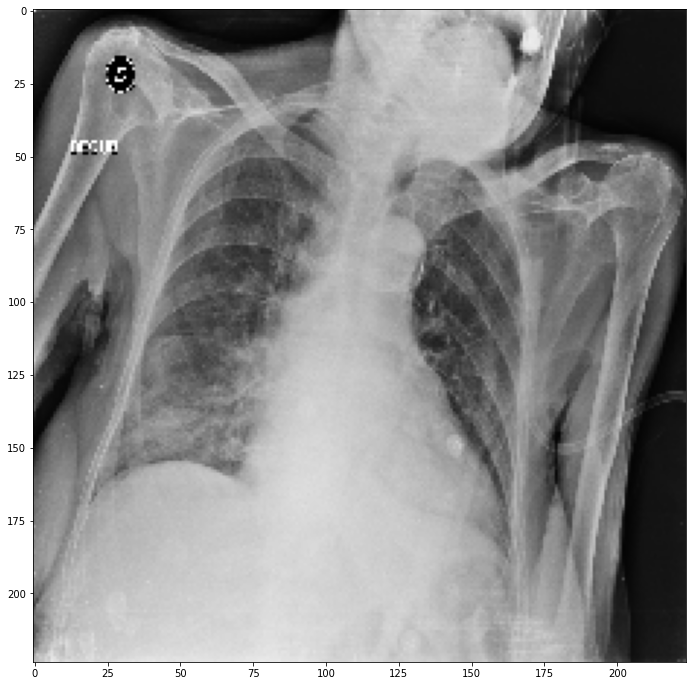

In [ ]:
# test image
file_path1 =  '/test/COVID19/COVID19(460).jpg'
test_image1 = cv2.imread(data_path + file_path1)
test_image1 = cv2.resize(test_image1, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image1)
test_image1 = np.expand_dims(test_image1,axis=0)

heatmap1, top_index1 = make_gradcam_heatmap(test_image1, model_vgg16, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index1])


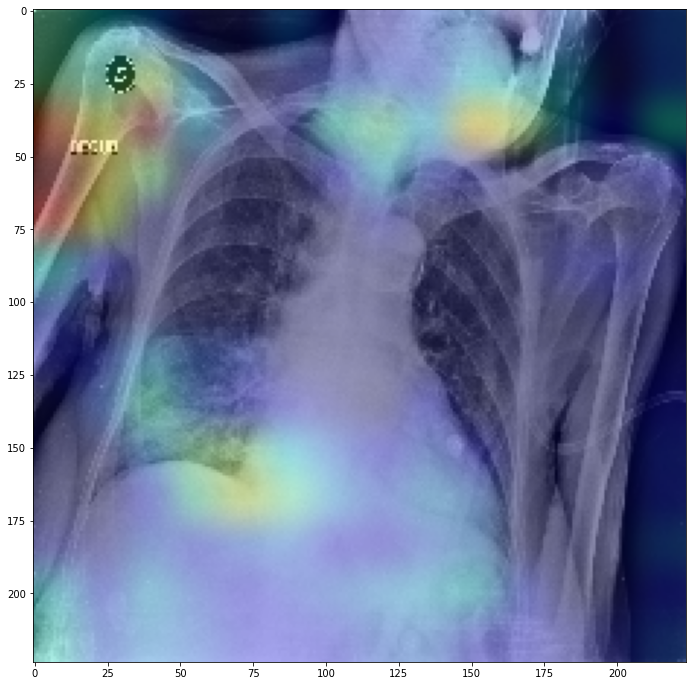

In [ ]:
s_img1 = superimposed_img(test_image1[0], heatmap1)
plt.figure(figsize=(15,12))
plt.imshow(s_img1)


predicted as COVID19


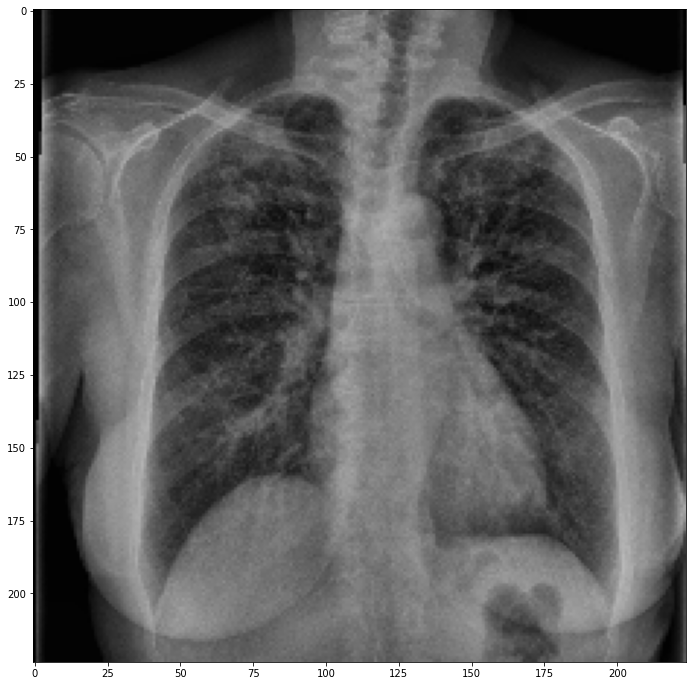

In [ ]:
# test image
file_path2 =  '/test/COVID19/COVID19(463).jpg'
test_image2 = cv2.imread(data_path + file_path2)
test_image2 = cv2.resize(test_image2, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image2)
test_image2 = np.expand_dims(test_image2,axis=0)

heatmap2, top_index2 = make_gradcam_heatmap(test_image2, model_vgg16, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index2])


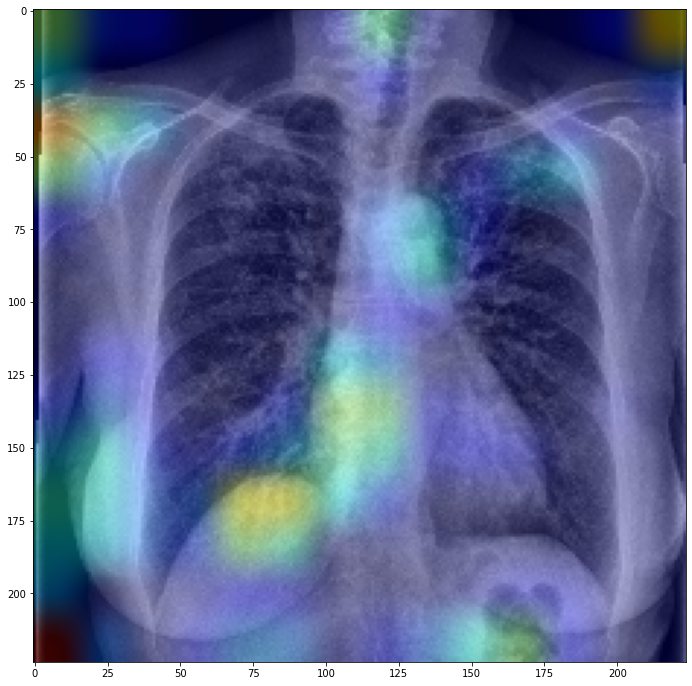

In [ ]:
s_img2 = superimposed_img(test_image2[0], heatmap2)
plt.figure(figsize=(15,12))
plt.imshow(s_img2)

predicted as COVID19


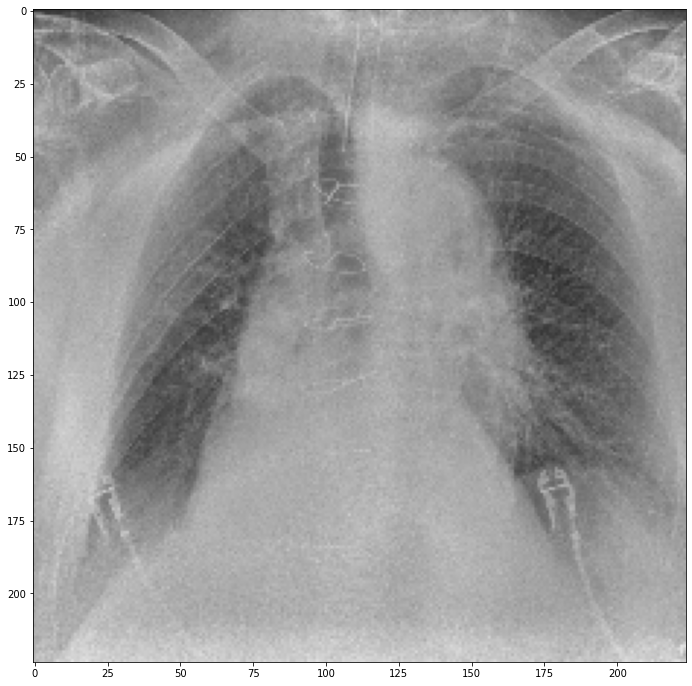

In [ ]:
# test image
file_path3 =  '/test/COVID19/COVID19(464).jpg'
test_image3 = cv2.imread(data_path + file_path3)
test_image3 = cv2.resize(test_image3, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image3)
test_image3 = np.expand_dims(test_image3,axis=0)

heatmap3, top_index3 = make_gradcam_heatmap(test_image3, model_vgg16, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index3])


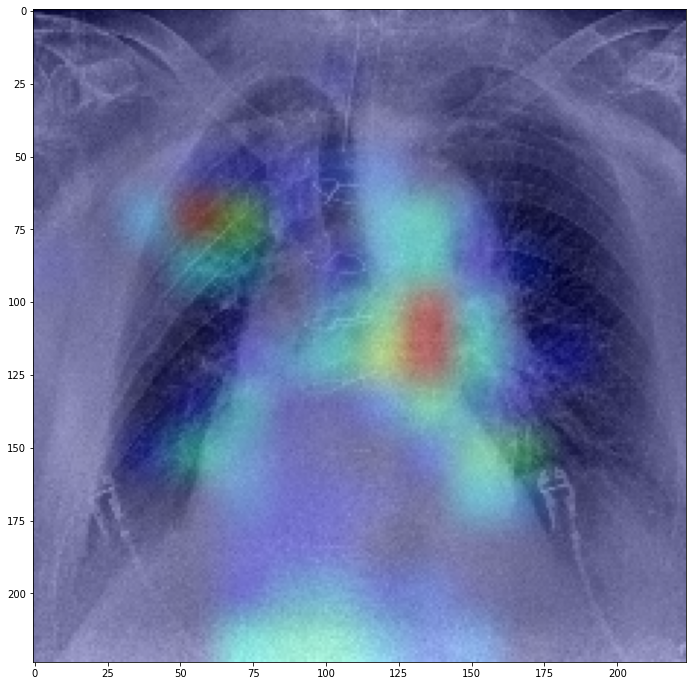

In [ ]:
s_img3 = superimposed_img(test_image3[0], heatmap3)
plt.figure(figsize=(15,12))
plt.imshow(s_img3)


predicted as COVID19


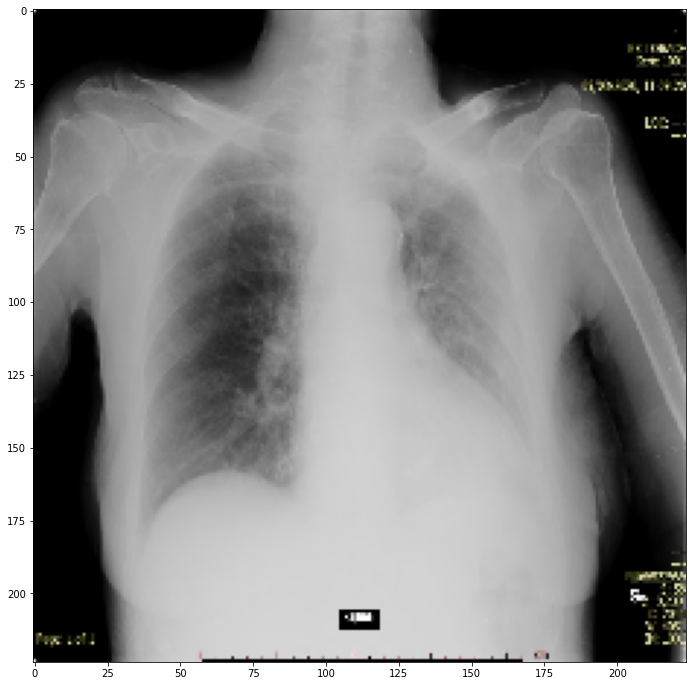

In [ ]:
# test image
file_path4 =  '/test/COVID19/COVID19(466).jpg'
test_image4 = cv2.imread(data_path + file_path4)
test_image4 = cv2.resize(test_image4, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image4)
test_image4 = np.expand_dims(test_image4,axis=0)

heatmap4, top_index4 = make_gradcam_heatmap(test_image4, model_vgg16, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index4])


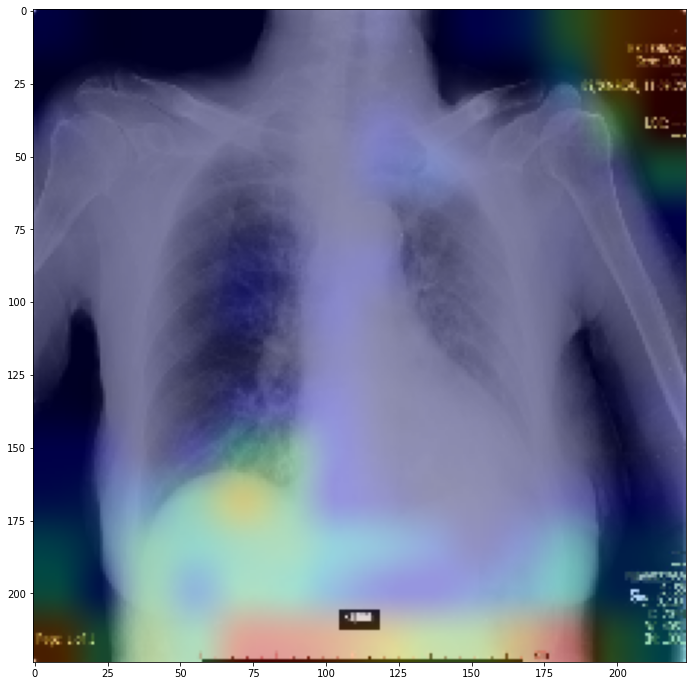

In [ ]:
s_img4 = superimposed_img(test_image4[0], heatmap4)
plt.figure(figsize=(15,12))
plt.imshow(s_img4)


predicted as COVID19


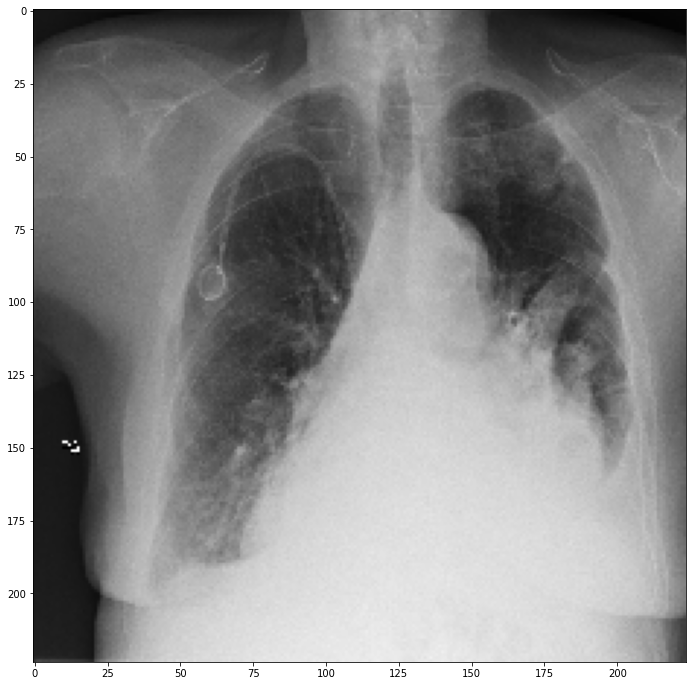

In [ ]:
# test image
file_path5 =  '/test/COVID19/COVID19(471).jpg'
test_image5 = cv2.imread(data_path + file_path5)
test_image5 = cv2.resize(test_image5, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image5)
test_image5 = np.expand_dims(test_image5,axis=0)

heatmap5, top_index5 = make_gradcam_heatmap(test_image5, model_vgg16, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index5])


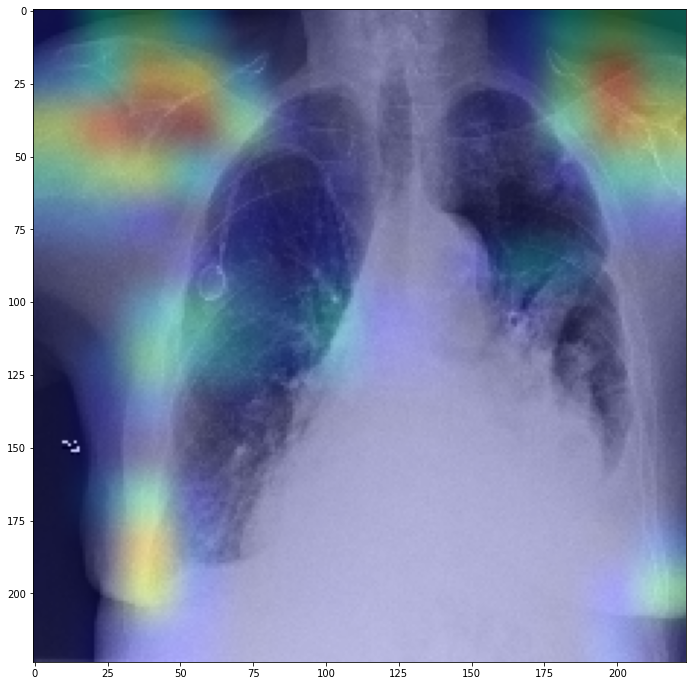

In [ ]:
s_img5 = superimposed_img(test_image5[0], heatmap5)
plt.figure(figsize=(15,12))
plt.imshow(s_img5)


## test CXR Normal

predicted as NORMAL


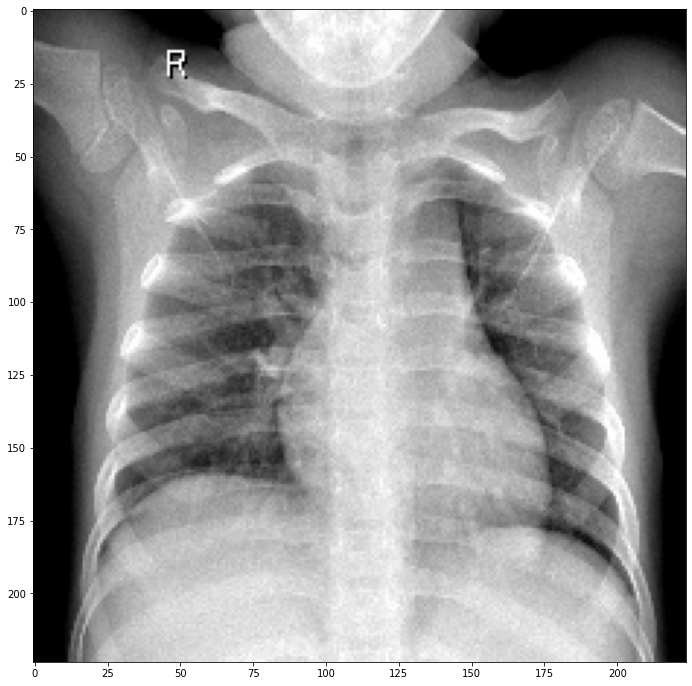

In [ ]:
# test image
file_path16 =  '/test/NORMAL/NORMAL(1267).jpg'
test_image16 = cv2.imread(data_path + file_path16)
test_image16 = cv2.resize(test_image16, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image16)
test_image16 = np.expand_dims(test_image16,axis=0)

heatmap16, top_index16 = make_gradcam_heatmap(test_image16, model_vgg16, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index16])


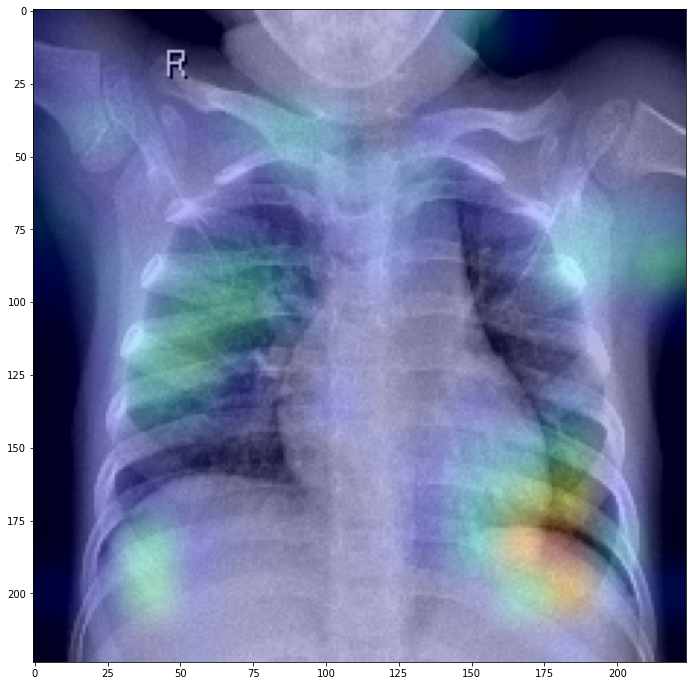

In [ ]:
s_img16 = superimposed_img(test_image16[0], heatmap16)
plt.figure(figsize=(15,12))
plt.imshow(s_img16)

predicted as NORMAL


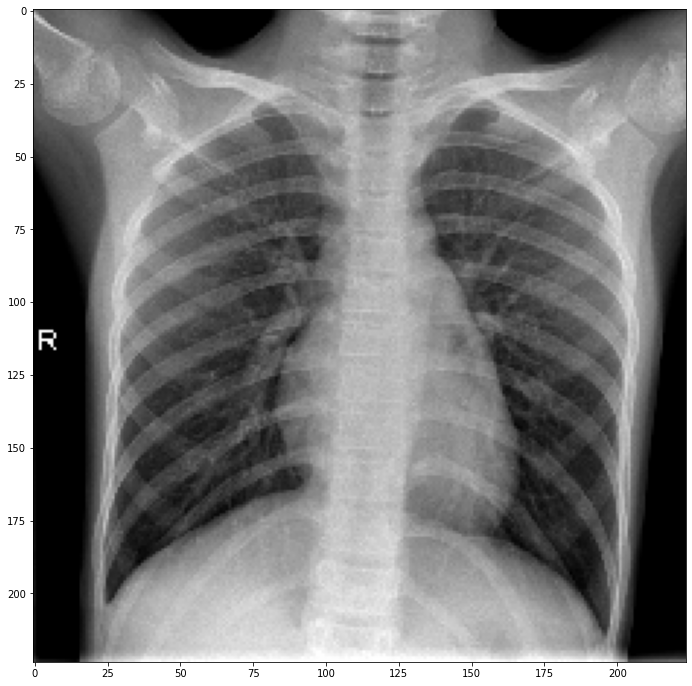

In [ ]:
# test image
file_path17 =  '/test/NORMAL/NORMAL(1290).jpg'
test_image17 = cv2.imread(data_path + file_path17)
test_image17 = cv2.resize(test_image17, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image17)
test_image17 = np.expand_dims(test_image17,axis=0)

heatmap17, top_index17 = make_gradcam_heatmap(test_image17, model_vgg16, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index17])


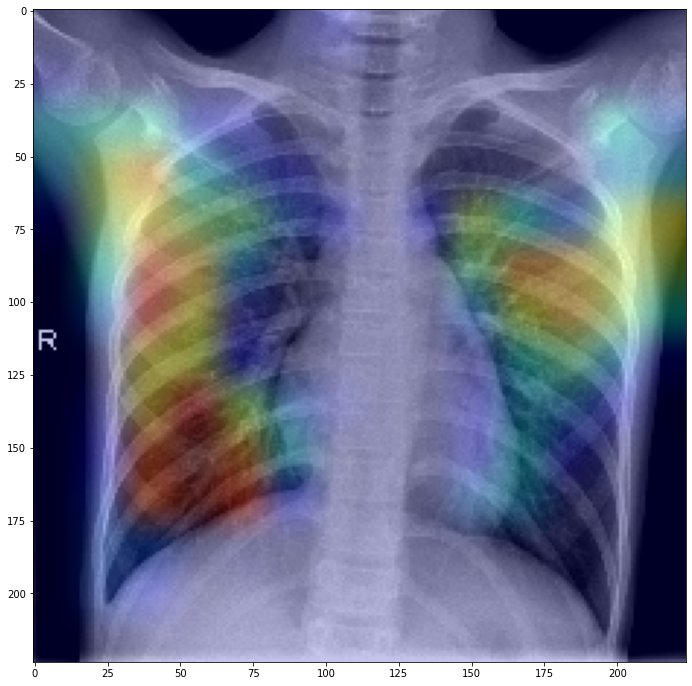

In [ ]:
s_img17 = superimposed_img(test_image17[0], heatmap17)
plt.figure(figsize=(15,12))
plt.imshow(s_img17)


predicted as NORMAL


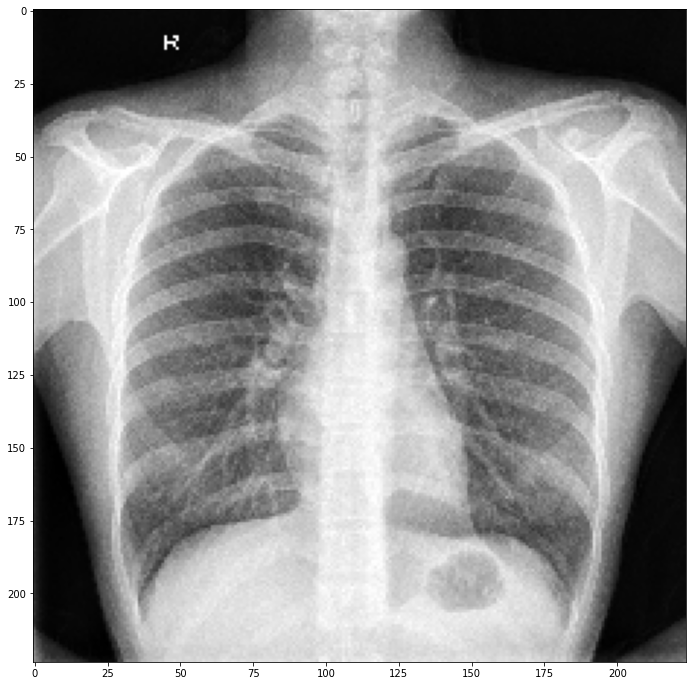

In [ ]:
# test image
file_path18 =  '/test/NORMAL/NORMAL(1283).jpg'
test_image18 = cv2.imread(data_path + file_path18)
test_image18 = cv2.resize(test_image18, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image18)
test_image18 = np.expand_dims(test_image18,axis=0)

heatmap18, top_index18 = make_gradcam_heatmap(test_image18, model_vgg16, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index18])


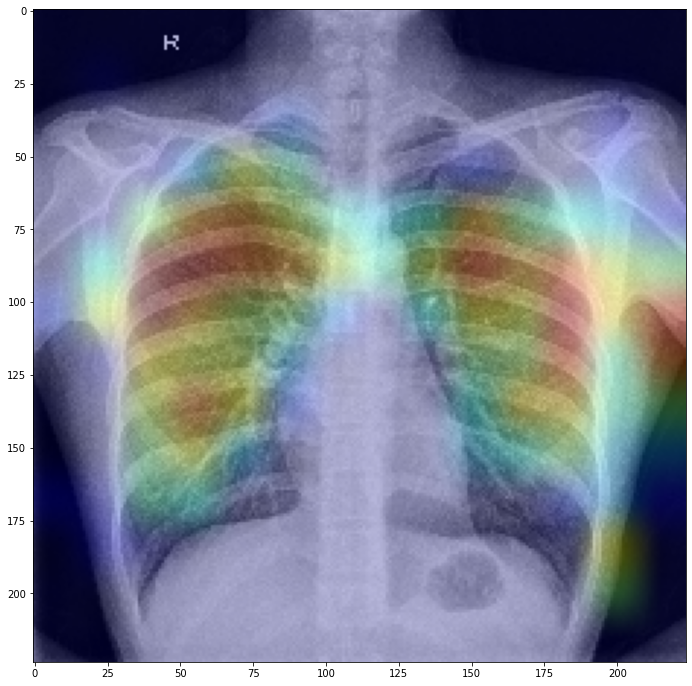

In [ ]:
s_img18 = superimposed_img(test_image18[0], heatmap18)
plt.figure(figsize=(15,12))
plt.imshow(s_img18)


predicted as NORMAL


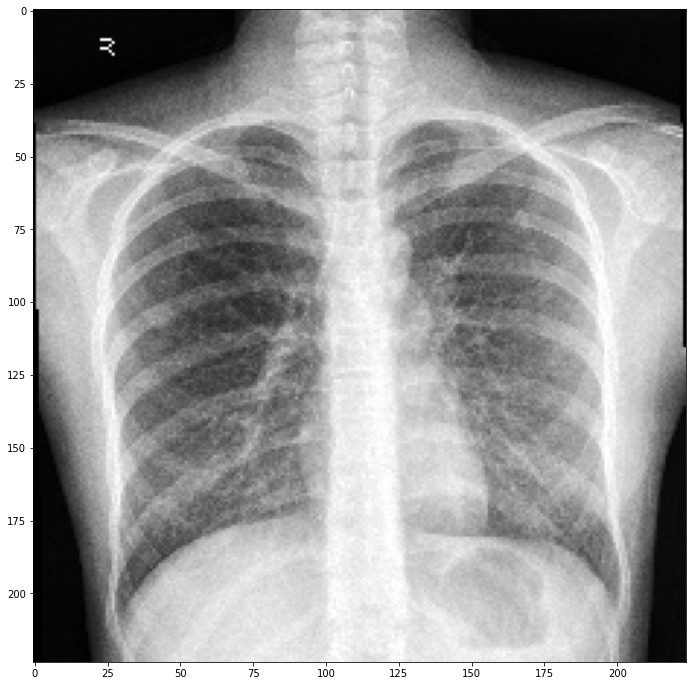

In [ ]:
# test image
file_path19 =  '/test/NORMAL/NORMAL(1299).jpg'
test_image19 = cv2.imread(data_path + file_path19)
test_image19 = cv2.resize(test_image19, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image19)
test_image19 = np.expand_dims(test_image19,axis=0)

heatmap19, top_index19 = make_gradcam_heatmap(test_image19, model_vgg16, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index19])


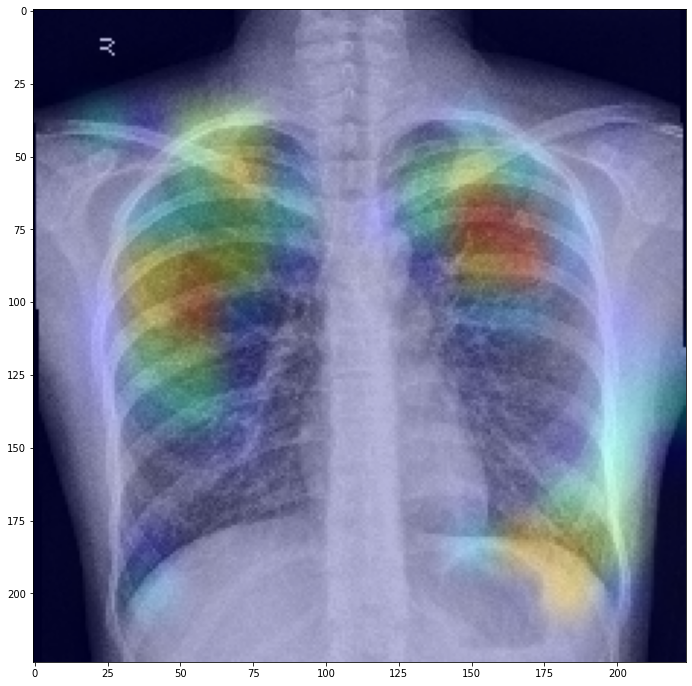

In [ ]:
s_img19 = superimposed_img(test_image19[0], heatmap19)
plt.figure(figsize=(15,12))
plt.imshow(s_img19)


predicted as NORMAL


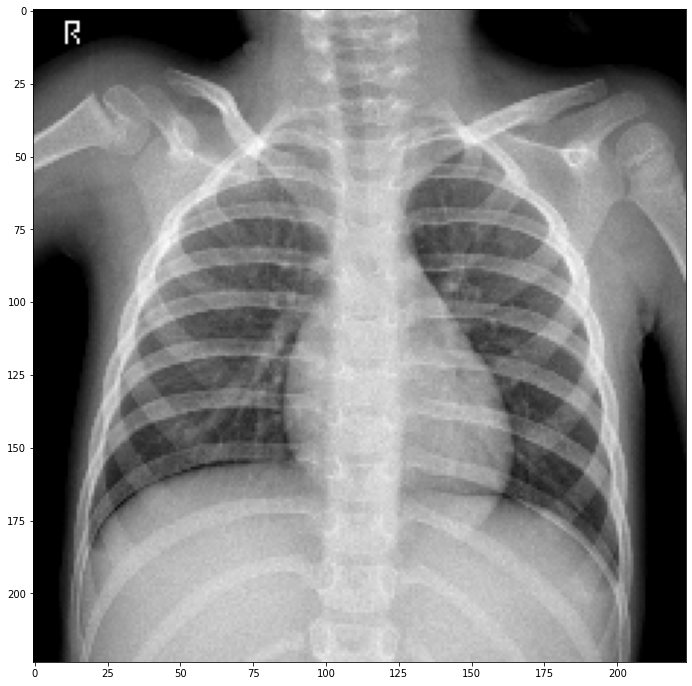

In [ ]:
# test image
file_path20 =  '/test/NORMAL/NORMAL(1309).jpg'
test_image20 = cv2.imread(data_path + file_path20)
test_image20 = cv2.resize(test_image20, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image20)
test_image20 = np.expand_dims(test_image20,axis=0)

heatmap20, top_index20 = make_gradcam_heatmap(test_image20, model_vgg16, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index20])


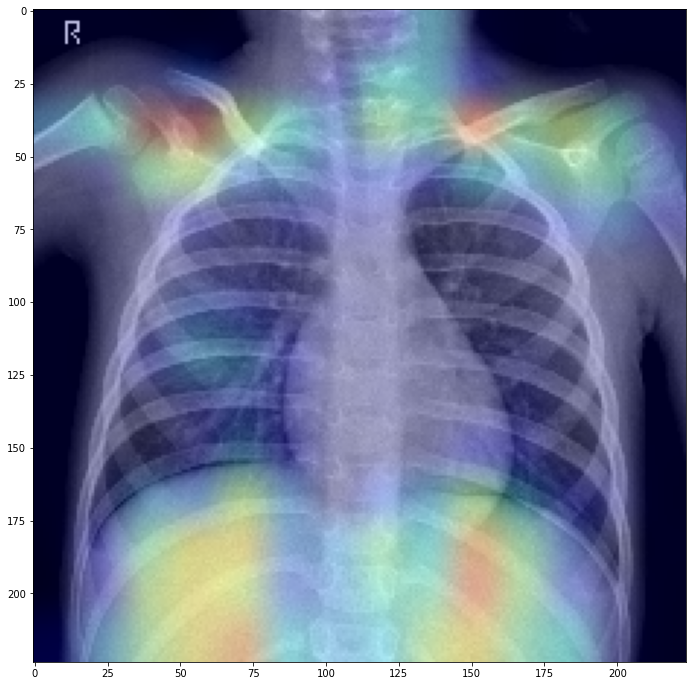

In [ ]:
s_img20 = superimposed_img(test_image20[0], heatmap20)
plt.figure(figsize=(15,12))
plt.imshow(s_img20)


## test CXR Pnuemonia

predicted as NORMAL


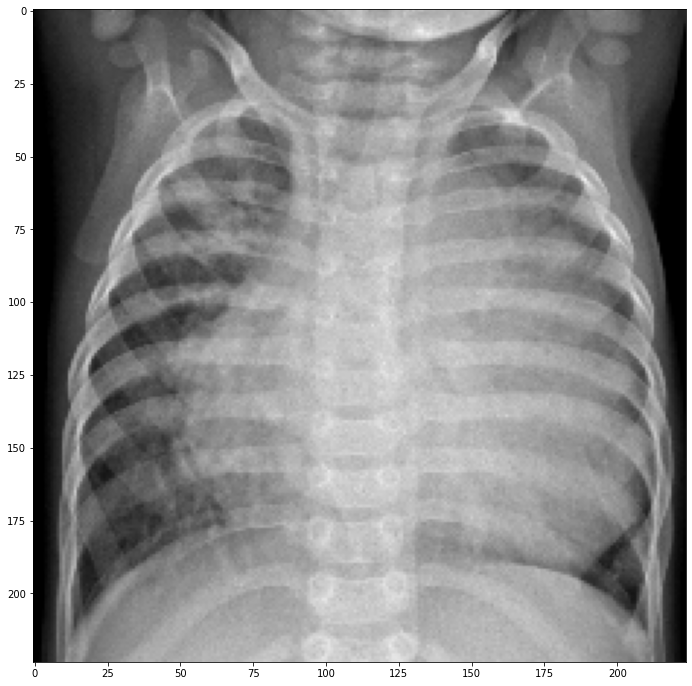

In [ ]:
# test image
file_path31 =  '/test/PNEUMONIA/PNEUMONIA(3419).jpg'
test_image31 = cv2.imread(data_path + file_path31)
test_image31 = cv2.resize(test_image31, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image31)
test_image31 = np.expand_dims(test_image31,axis=0)

heatmap31, top_index31 = make_gradcam_heatmap(test_image31, model_vgg16, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index31])


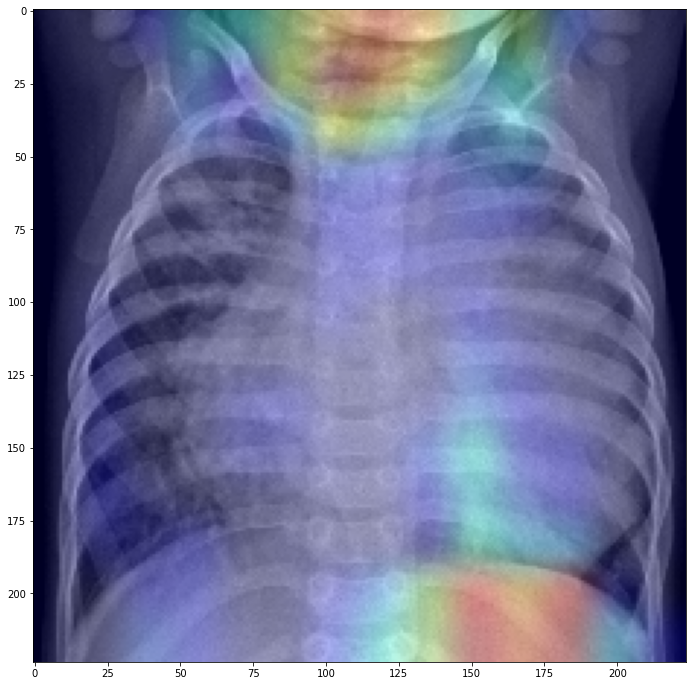

In [ ]:
s_img31 = superimposed_img(test_image31[0], heatmap31)
plt.figure(figsize=(15,12))
plt.imshow(s_img31)


predicted as COVID19


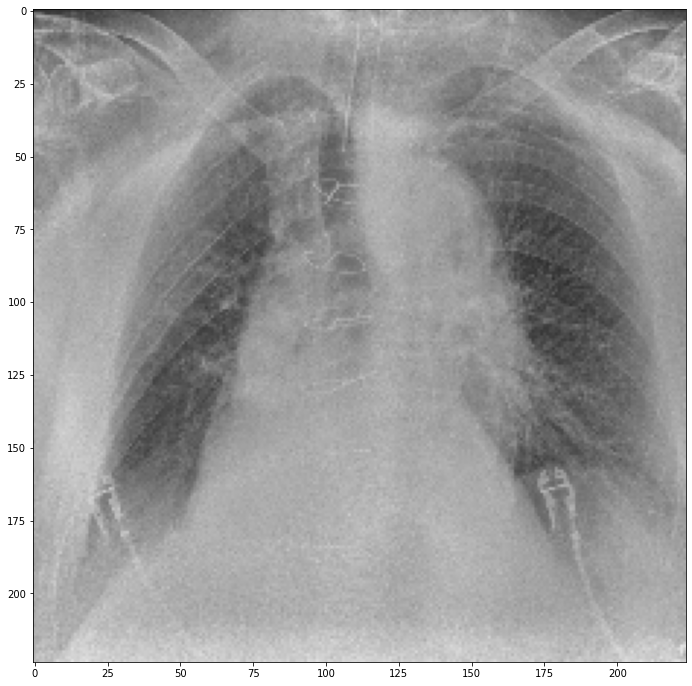

In [ ]:
# test image
file_path32 =  '/test/PNEUMONIA/PNEUMONIA(3420).jpg'
test_image32 = cv2.imread(data_path + file_path3)
test_image32 = cv2.resize(test_image32, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image32)
test_image32 = np.expand_dims(test_image32,axis=0)

heatmap32, top_index32 = make_gradcam_heatmap(test_image32, model_vgg16, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index32])


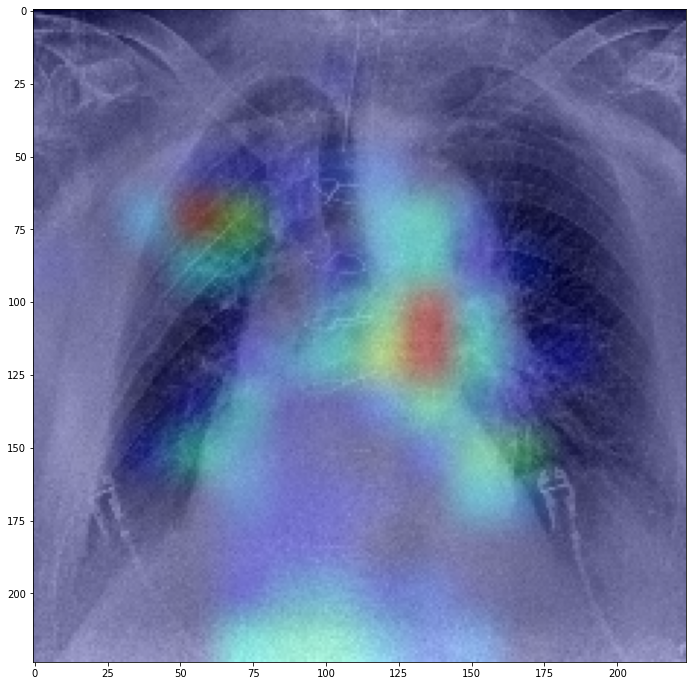

In [ ]:
s_img32 = superimposed_img(test_image32[0], heatmap32)
plt.figure(figsize=(15,12))
plt.imshow(s_img32)


predicted as NORMAL


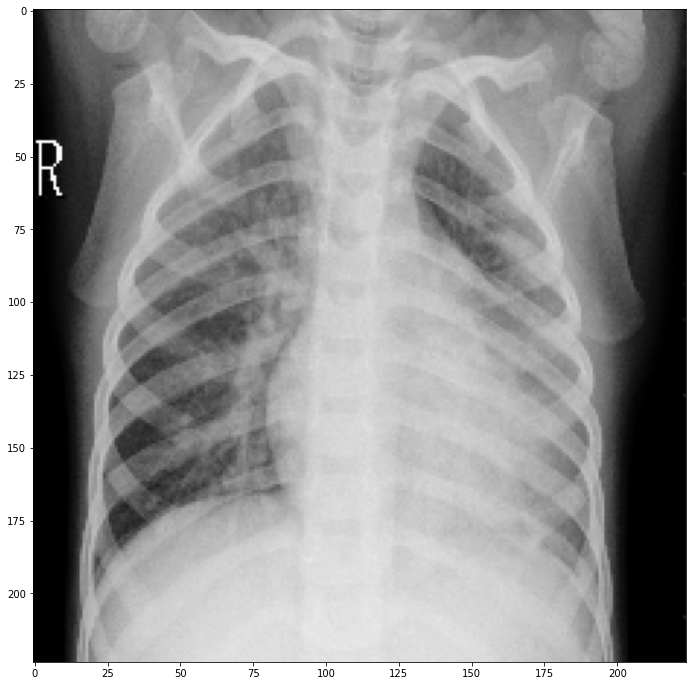

In [ ]:
# test image
file_path33 =  '/test/PNEUMONIA/PNEUMONIA(3455).jpg'
test_image33 = cv2.imread(data_path + file_path33)
test_image33 = cv2.resize(test_image33, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image33)
test_image33 = np.expand_dims(test_image33,axis=0)

heatmap33, top_index33 = make_gradcam_heatmap(test_image3, model_vgg16, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index33])


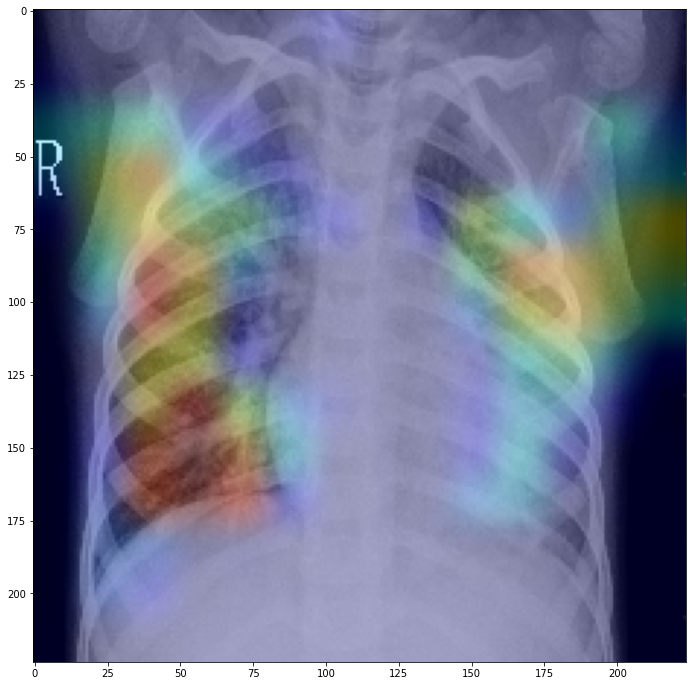

In [ ]:
s_img33 = superimposed_img(test_image33[0], heatmap33)
plt.figure(figsize=(15,12))
plt.imshow(s_img33)


predicted as NORMAL


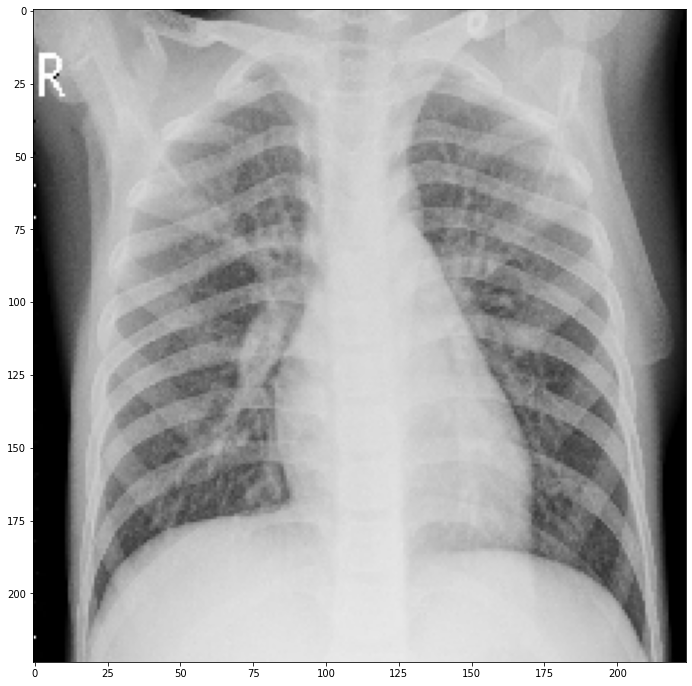

In [ ]:
# test image
file_path34 =  '/test/PNEUMONIA/PNEUMONIA(3466).jpg'
test_image34 = cv2.imread(data_path + file_path34)
test_image34 = cv2.resize(test_image34, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image34)
test_image34 = np.expand_dims(test_image34,axis=0)

heatmap34, top_index34 = make_gradcam_heatmap(test_image34, model_vgg16, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index34])

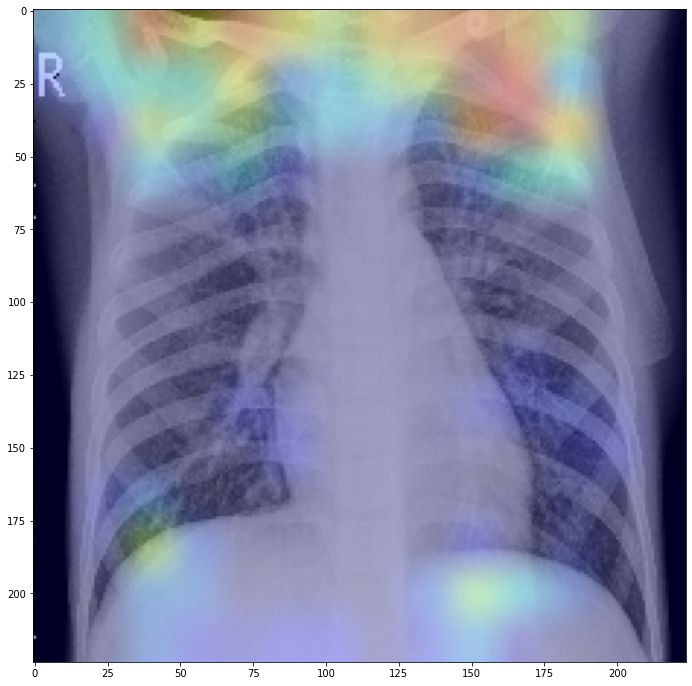

In [ ]:
s_img34 = superimposed_img(test_image34[0], heatmap34)
plt.figure(figsize=(15,12))
plt.imshow(s_img34)

predicted as PNEUMONIA


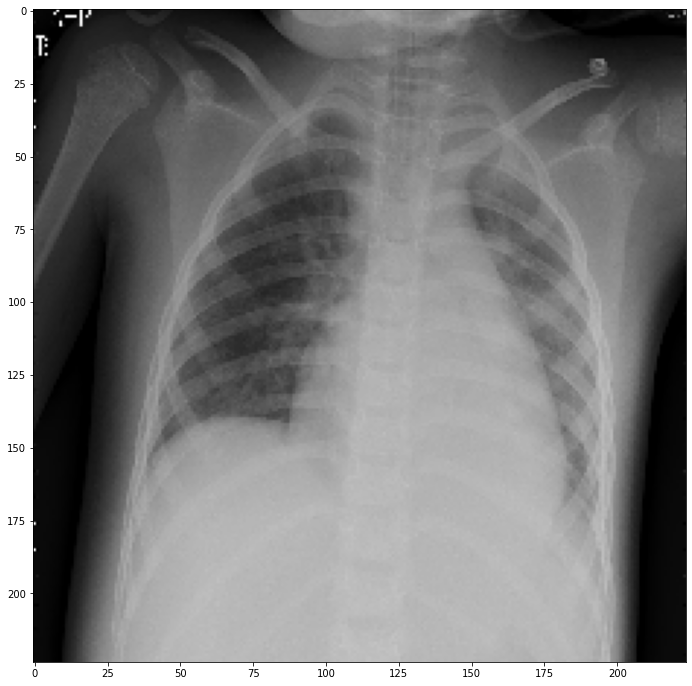

In [ ]:
# test image
file_path35 =  '/test/PNEUMONIA/PNEUMONIA(3555).jpg'
test_image35 = cv2.imread(data_path + file_path35)
test_image35 = cv2.resize(test_image35, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image35)
test_image35 = np.expand_dims(test_image35,axis=0)

heatmap35, top_index35 = make_gradcam_heatmap(test_image35, model_vgg16, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index35])


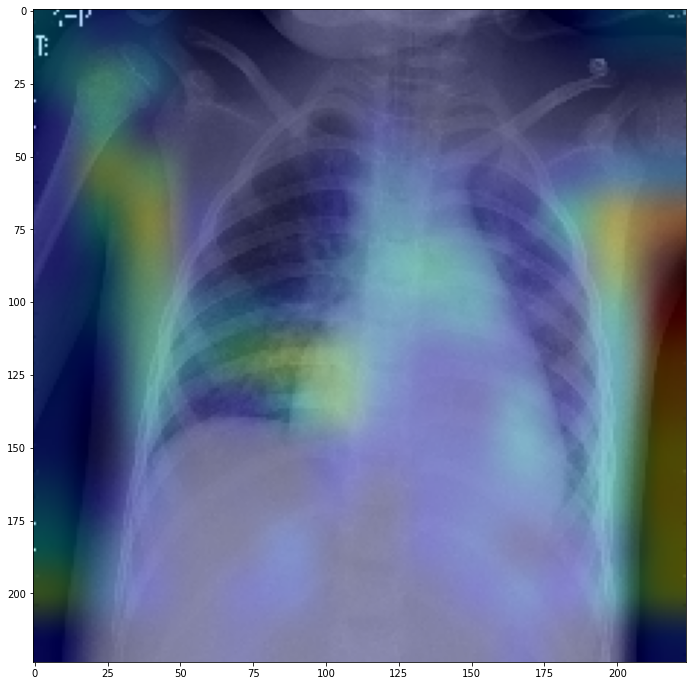

In [ ]:
s_img35 = superimposed_img(test_image35[0], heatmap35)
plt.figure(figsize=(15,12))
plt.imshow(s_img35)


# ResNet50

In [ ]:
pretrained_resnet50 = tf.keras.applications.ResNet50(input_shape=(image_size, image_size, 3), weights='imagenet', include_top=False)
 
for layer in pretrained_resnet50.layers:
  layer.trainable = False
 
x4 = pretrained_resnet50.output
x4 = tf.keras.layers.AveragePooling2D(name="averagepooling2d_head")(x4)
x4 = tf.keras.layers.Flatten(name="flatten_head")(x4)
x4 = tf.keras.layers.Dense(64, activation="relu", name="dense_head")(x4)
x4 = tf.keras.layers.Dropout(0.5, name="dropout_head")(x4)
model_out = tf.keras.layers.Dense(3, activation='softmax', name="predictions_head")(x4)
 
model_resnet50 = Model(inputs=pretrained_resnet50.input, outputs=model_out)
model_resnet50.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),loss=categorical_smooth_loss,metrics=['accuracy',tf.keras.metrics.Precision(),tf.keras.metrics.Recall()])
 
model_resnet50.summary()

94773248/94765736 [==============================] - 0s 0us/step
Model: "model_129"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_67 (InputLayer)           [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 230, 230, 3)  0           input_67[0][0]                   
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 112, 112, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, 112, 112, 64) 256         conv1_conv[0][0]                 
_________________________

In [ ]:
history_resnet50 = model_resnet50.fit_generator(training_set, validation_data=testing_set, callbacks=[lr_reduce, es_callback], epochs=30)   

/usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/engine/training.py:1844: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Epoch 1/30
81/81 [==============================] - 194s 2s/step - loss: 0.9843 - accuracy: 0.5932 - precision_1: 0.6220 - recall_1: 0.4687 - val_loss: 0.8695 - val_accuracy: 0.6638 - val_precision_1: 0.6638 - val_recall_1: 0.6638
Epoch 2/30
81/81 [==============================] - 189s 2s/step - loss: 0.9150 - accuracy: 0.6470 - precision_1: 0.6646 - recall_1: 0.5148 - val_loss: 0.8444 - val_accuracy: 0.6638 - val_precision_1: 0.6638 - val_recall_1: 0.6638
Epoch 3/30
81/81 [==============================] - 189s 2s/step - loss: 0.8879 - accuracy: 0.6608 - precision_1: 0.6772 - recall_1: 0.5282 - val_loss: 0.8360 - val_accuracy: 0.6638 - val_precision_1: 0.6865 - val_recall_1: 0.6460
Epoch 4/30
81/81 [==============================] - 189s 2s/step - loss: 0.8734 - accuracy: 0.6655 - precision_1: 0.6816 - recall_1: 0.5346 - val_loss: 0.8205 - val_accuracy: 0.6638 - val_precision_1: 0.6953 - val_recall_1: 0.6413
Epoch 5/30
81/81 [==============================] - 190s 2s/step - loss: 0.8

In [ ]:
model_resnet50.save("model_resnet50_30_01996.h5")
print(history_resnet50.history.keys())

dict_keys(['loss', 'accuracy', 'precision_1', 'recall_1', 'val_loss', 'val_accuracy', 'val_precision_1', 'val_recall_1', 'lr'])


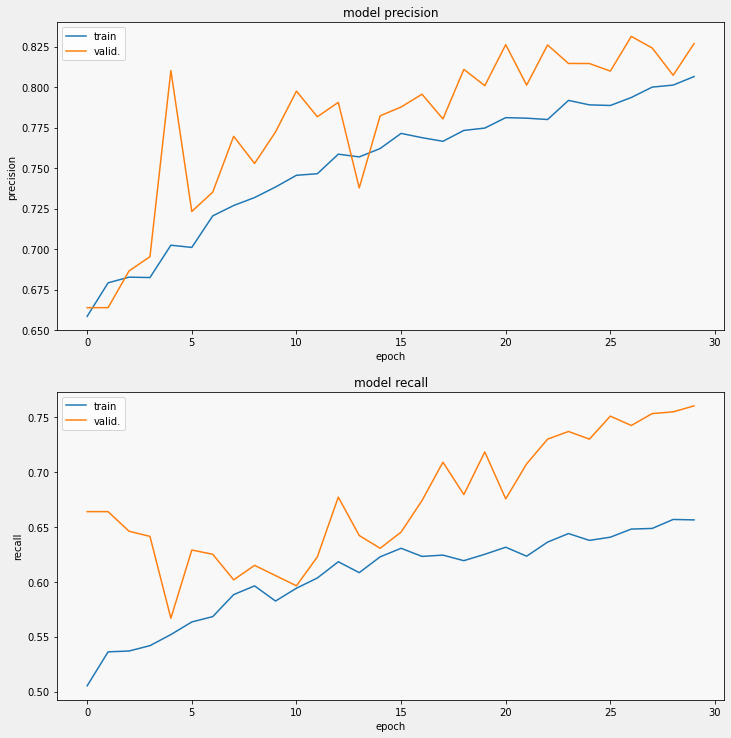

In [ ]:
display_training_curves(history_resnet50.history['precision_1'], history_resnet50.history['val_precision_1'], 'precision', 211)
display_training_curves(history_resnet50.history['recall_1'], history_resnet50.history['val_recall_1'], 'recall', 212)

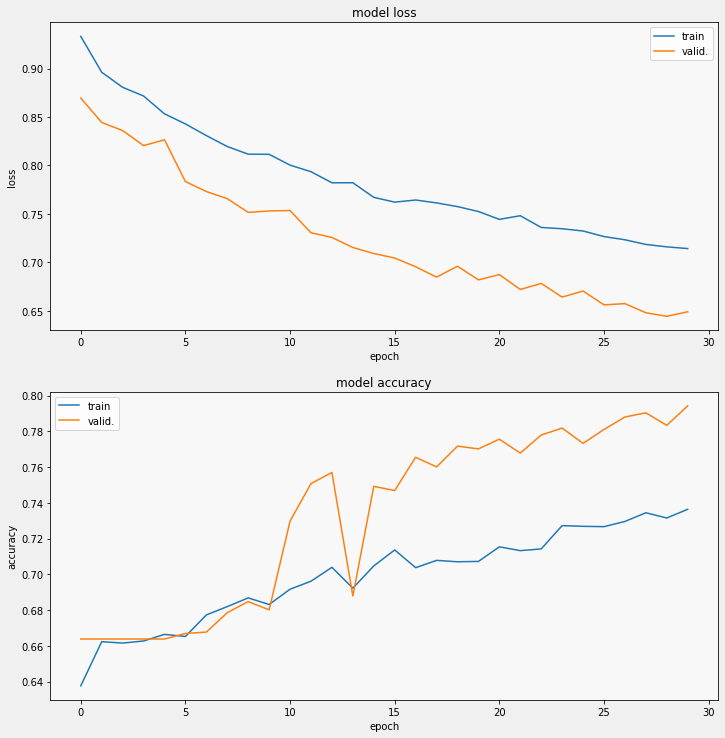

In [ ]:
display_training_curves(history_resnet50.history['loss'], history_resnet50.history['val_loss'], 'loss', 211)
display_training_curves(history_resnet50.history['accuracy'], history_resnet50.history['val_accuracy'], 'accuracy', 212)

In [ ]:
last_conv_layer_name = "conv5_block3_add"
classifier_layer_names = [
    "conv5_block3_out",
    "averagepooling2d_head",
    "flatten_head",
    "dense_head",
    "dropout_head",
    "predictions_head"
]

## confusion matrix

[[ 0  1  7]
 [ 0 17  2]
 [ 0  2 35]]
TP: 52
FP: 0
FN: 8
Precision: 1.0
Recall: 0.8666666666666667
TP: 52
FP: 3
FN: 2
Precision: 0.9454545454545454
Recall: 0.9629629629629629
TP: 52
FP: 9
FN: 2
Precision: 0.8524590163934426
Recall: 0.9629629629629629
Precision and Recall Matrix: 
[[1.         0.86666667]
 [0.94545455 0.96296296]
 [0.85245902 0.96296296]]
Total instances: 64
Accuracy: 0.8125


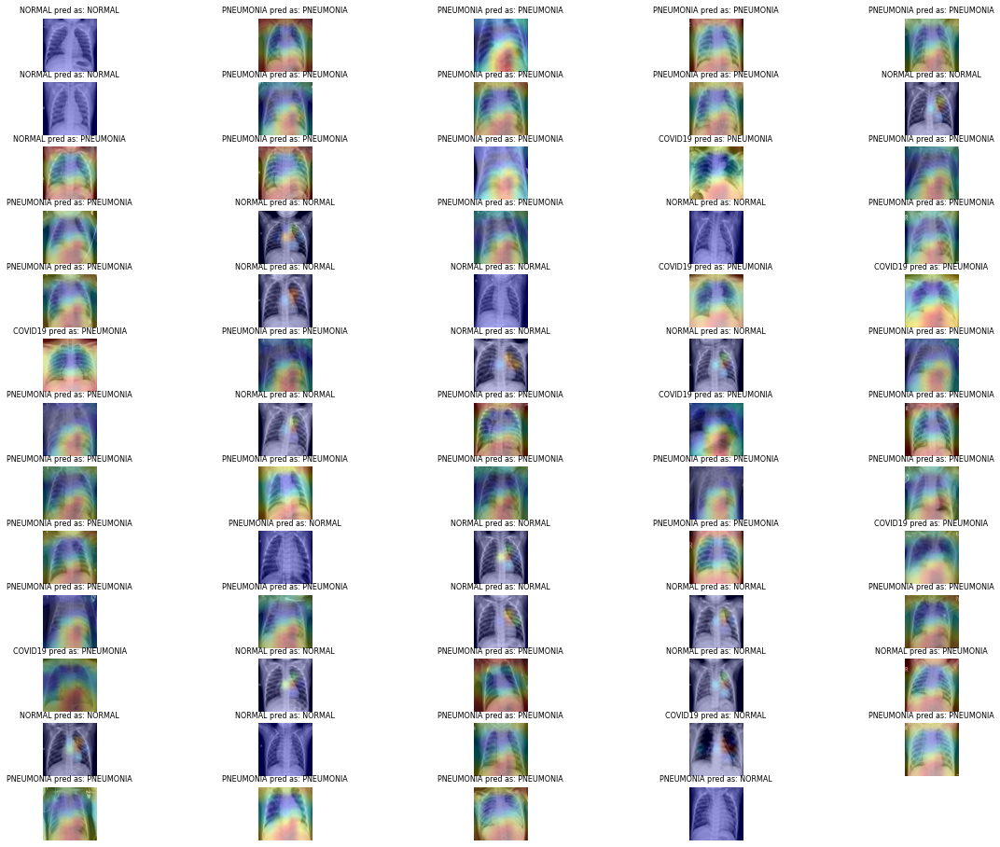

In [ ]:
cmatrix = np.zeros((3,3),dtype=int)
p_r_matrix = np.zeros((3,2),dtype=float)
plt.figure(figsize=(20,20))
for i in range(len(sample_data)):
    plt.subplot(16, 5, i+1)
    plt.axis('off')
    heatmap, top_index = make_gradcam_heatmap(np.expand_dims(sample_data[i], axis=0), model_resnet50, last_conv_layer_name, classifier_layer_names)
    img = np.uint8(255 * sample_data[i])
    s_img = superimposed_img(img, heatmap)
    plt.imshow(s_img)
    plt.title(labels[np.argmax(sample_label[i])] + " pred as: " + labels[top_index], fontsize=8)
    row = np.argmax(sample_label[i])
    col = top_index
    cmatrix[row,col] = cmatrix[row,col]+1
print(cmatrix)

for i in range(p_r_matrix.shape[0]):
    recall = 0
    precision = 0
    TP = 0
    FP = 0
    FN = 0
    for j in range(cmatrix.shape[0]):
        TP = TP + cmatrix[j,j]
        if i is not j:
            FP = FP + cmatrix[j,i]
            FN = FN + cmatrix[i,j]
    print("TP: " + str(TP))
    print("FP: " + str(FP))
    print("FN: " + str(FN))
    precision = TP/(TP + FP)
    recall = TP/(TP + FN)
    p_r_matrix[i,0] = precision
    p_r_matrix[i,1] = recall
    print("Precision: " + str(precision))
    print("Recall: " + str(recall))
print("Precision and Recall Matrix: ")
print(p_r_matrix)

accuracy = 0
TP = 0
for i in range(cmatrix.shape[0]):
    TP = TP + cmatrix[i,i]
print("Total instances: " + str(np.sum(cmatrix)))
accuracy = TP/np.sum(cmatrix)
print("Accuracy: " + str(accuracy))

In [ ]:
evaluation = model_resnet50.evaluate(testing_set, return_dict=True)

21/21 [==============================] - 29s 1s/step - loss: 0.6489 - accuracy: 0.7943 - precision_1: 0.8269 - recall_1: 0.7601


In [ ]:
# make predictions on the testing set
print("[INFO] evaluating network...")
print("resnet50")
predIdxs3 = model_resnet50.predict(sample_data, batch_size=BATCH_SIZE)
# for each image in the testing set we need to find the index of the
# label with corresponding largest predicted probability
predIdxs3 = np.argmax(predIdxs3, axis=1)
# show a nicely formatted classification report
print(classification_report(sample_label.argmax(axis=1), predIdxs3, 
                            target_names=labels))

[INFO] evaluating network...
vgg16
              precision    recall  f1-score   support

     COVID19       1.00      0.88      0.93         8
      NORMAL       1.00      0.95      0.97        19
   PNEUMONIA       0.95      1.00      0.97        37

    accuracy                           0.97        64
   macro avg       0.98      0.94      0.96        64
weighted avg       0.97      0.97      0.97        64



In [ ]:
# compute the confusion matrix and and use it to derive the raw
# accuracy, sensitivity, and specificity
print("resnet50")
cm = confusion_matrix(sample_label.argmax(axis=1), predIdxs3)
total = sum(sum(cm))
acc = (cm[0, 0] + cm[1, 1]) / total
sensitivity = cm[0, 0] / (cm[0, 0] + cm[0, 1])
specificity = cm[1, 1] / (cm[1, 0] + cm[1, 1])
# show the confusion matrix, accuracy, sensitivity, and specificity
print(cm)
print("acc: {:.4f}".format(acc))
print("sensitivity: {:.4f}".format(sensitivity))
print("specificity: {:.4f}".format(specificity))

vgg16
[[ 7  0  1]
 [ 0 18  1]
 [ 0  0 37]]
acc: 0.3906
sensitivity: 1.0000
specificity: 1.0000


## test CXR COVID

In [ ]:
# test image
file_path1 =  '/test/COVID19/COVID19(460).jpg'
test_image1 = cv2.imread(data_path + file_path1)
test_image1 = cv2.resize(test_image1, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image1)
test_image1 = np.expand_dims(test_image1,axis=0)

heatmap1, top_index1 = make_gradcam_heatmap(test_image1, model_resnet50, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index1])


In [ ]:
s_img1 = superimposed_img(test_image1[0], heatmap1)
plt.figure(figsize=(15,12))
plt.imshow(s_img1)


In [ ]:
# test image
file_path2 =  '/test/COVID19/COVID19(463).jpg'
test_image2 = cv2.imread(data_path + file_path2)
test_image2 = cv2.resize(test_image2, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image2)
test_image2 = np.expand_dims(test_image2,axis=0)

heatmap2, top_index2 = make_gradcam_heatmap(test_image2, model_resnet50, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index2])


In [ ]:
s_img2 = superimposed_img(test_image2[0], heatmap2)
plt.figure(figsize=(15,12))
plt.imshow(s_im2)


In [ ]:
# test image
file_path3 =  '/test/COVID19/COVID19(464).jpg'
test_image3 = cv2.imread(data_path + file_path3)
test_image3 = cv2.resize(test_image3, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image3)
test_image3 = np.expand_dims(test_image3,axis=0)

heatmap3, top_index3 = make_gradcam_heatmap(test_image3, model_resnet50, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index3])


In [ ]:
s_img3 = superimposed_img(test_image3[0], heatmap3)
plt.figure(figsize=(15,12))
plt.imshow(s_img3)


In [ ]:
# test image
file_path4 =  '/test/COVID19/COVID19(466).jpg'
test_image4 = cv2.imread(data_path + file_path4)
test_image4 = cv2.resize(test_image4, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image4)
test_image4 = np.expand_dims(test_image4,axis=0)

heatmap4, top_index4 = make_gradcam_heatmap(test_image4, model_resnet50, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index4])


In [ ]:
s_img4 = superimposed_img(test_image4[0], heatmap4)
plt.figure(figsize=(15,12))
plt.imshow(s_img4)


In [ ]:
# test image
file_path5 =  '/test/COVID19/COVID19(471).jpg'
test_image5 = cv2.imread(data_path + file_path5)
test_image5 = cv2.resize(test_image5, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image5)
test_image5 = np.expand_dims(test_image5,axis=0)

heatmap5, top_index5 = make_gradcam_heatmap(test_image5, model_resnet50, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index5])


In [ ]:
s_img5 = superimposed_img(test_image5[0], heatmap5)
plt.figure(figsize=(15,12))
plt.imshow(s_img5)


## test CXR Normal

In [ ]:
# test image
file_path16 =  '/test/NORMAL/NORMAL(1267).jpg'
test_image16 = cv2.imread(data_path + file_path16)
test_image16 = cv2.resize(test_image16, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image16)
test_image16 = np.expand_dims(test_image16,axis=0)

heatmap16, top_index16 = make_gradcam_heatmap(test_image16, model_resnet50, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index16])



In [ ]:
s_img16 = superimposed_img(test_image16[0], heatmap16)
plt.figure(figsize=(15,12))
plt.imshow(s_img16)


In [ ]:
# test image
file_path17 =  '/test/NORMAL/NORMAL(1270).jpg'
test_image17 = cv2.imread(data_path + file_path17)
test_image17 = cv2.resize(test_image17, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image17)
test_image3 = np.expand_dims(test_image17,axis=0)

heatmap17, top_index17 = make_gradcam_heatmap(test_image17, model_resnet50, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index17])


In [ ]:
s_img17 = superimposed_img(test_image17[0], heatmap17)
plt.figure(figsize=(15,12))
plt.imshow(s_img17)


In [ ]:
# test image
file_path18 =  '/test/NORMAL/NORMAL(1283).jpg'
test_image18 = cv2.imread(data_path + file_path18)
test_image18 = cv2.resize(test_image18, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image18)
test_image18 = np.expand_dims(test_image18,axis=0)

heatmap18, top_index18 = make_gradcam_heatmap(test_image18, model_resnet50, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index18])


In [ ]:
s_img18 = superimposed_img(test_image18[0], heatmap18)
plt.figure(figsize=(15,12))
plt.imshow(s_img18)


In [ ]:
# test image
file_path19 =  '/test/NORMAL/NORMAL(1299).jpg'
test_image19 = cv2.imread(data_path + file_path19)
test_image19 = cv2.resize(test_image19, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image19)
test_image3 = np.expand_dims(test_image3,axis=0)

heatmap19, top_index19 = make_gradcam_heatmap(test_image19, model_resnet50, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index19])


In [ ]:
s_img19 = superimposed_img(test_image19[0], heatmap19)
plt.figure(figsize=(15,12))
plt.imshow(s_img19)


In [ ]:
# test image
file_path20 =  '/test/NORMAL/NORMAL(1309).jpg'
test_image20 = cv2.imread(data_path + file_path20)
test_image20 = cv2.resize(test_image20, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image20)
test_image20 = np.expand_dims(test_image20,axis=0)

heatmap20, top_index20 = make_gradcam_heatmap(test_image20, model_resnet50, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index20])


In [ ]:
s_img20 = superimposed_img(test_image20[0], heatmap20)
plt.figure(figsize=(15,12))
plt.imshow(s_img20)


## test CXR Pnuemonia

In [ ]:
# test image
file_path31 =  '/test/PNEUMONIA/PNEUMONIA(460).jpg'
test_image31 = cv2.imread(data_path + file_path31)
test_image31 = cv2.resize(test_image31, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image31)
test_image31 = np.expand_dims(test_image31,axis=0)

heatmap31, top_index31 = make_gradcam_heatmap(test_image31, model_resnet50, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index31])


In [ ]:
s_img31 = superimposed_img(test_image31[0], heatmap31)
plt.figure(figsize=(15,12))
plt.imshow(s_img31)


In [ ]:
# test image
file_path32 =  '/test/PNEUMONIA/PNEUMONIA(460).jpg'
test_image32 = cv2.imread(data_path + file_path3)
test_image32 = cv2.resize(test_image32, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image32)
test_image32 = np.expand_dims(test_image32,axis=0)

heatmap32, top_index32 = make_gradcam_heatmap(test_image32, model_resnet50, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index32])


In [ ]:
s_img32 = superimposed_img(test_image32[0], heatmap32)
plt.figure(figsize=(15,12))
plt.imshow(s_img32)

In [ ]:
# test image
file_path33 =  '/test/PNEUMONIA/PNEUMONIA(460).jpg'
test_image33 = cv2.imread(data_path + file_path3)
test_image33 = cv2.resize(test_image33, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image33)
test_image33 = np.expand_dims(test_image33,axis=0)

heatmap33, top_index33 = make_gradcam_heatmap(test_image3, model_resnet50, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index33])


In [ ]:
s_img33 = superimposed_img(test_image33[0], heatmap33)
plt.figure(figsize=(15,12))
plt.imshow(s_img33)


In [ ]:
# test image
file_path34 =  '/test/PNEUMONIA/PNEUMONIA(460).jpg'
test_image34 = cv2.imread(data_path + file_path34)
test_image34 = cv2.resize(test_image34, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image34)
test_image34 = np.expand_dims(test_image34,axis=0)

heatmap34, top_index34 = make_gradcam_heatmap(test_image34, model_resnet50, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index34])


In [ ]:
s_img34 = superimposed_img(test_image34[0], heatmap34)
plt.figure(figsize=(15,12))
plt.imshow(s_img34)


In [ ]:
# test image
file_path35 =  '/test/PNEUMONIA/PNEUMONIA(460).jpg'
test_image35 = cv2.imread(data_path + file_path35)
test_image35 = cv2.resize(test_image35, (224,224),interpolation=cv2.INTER_NEAREST)
plt.figure(figsize=(15,12))
plt.imshow(test_image35)
test_image35 = np.expand_dims(test_image35,axis=0)

heatmap35, top_index35 = make_gradcam_heatmap(test_image35, model_resnet50, last_conv_layer_name, classifier_layer_names)
print("predicted as", labels[top_index35])


In [ ]:
s_img35 = superimposed_img(test_image35[0], heatmap35)
plt.figure(figsize=(15,12))
plt.imshow(s_img35)
